# Deep Learning for Image Analysis (DLIM)

**Subject**: Generation of Japanese paintings from sketches

**Authors**:

- Nicolas Blin (nicolas.blin@epita.fr)
- Ilan Guenet (ilan.guenet@epita.fr)
- Quentin Kaci (quentin.kaci@epita.fr)
- Theo Lepage (theo.lepage@epita.fr)

---

# Part 2 - Model and trainings

## Table of content

1. [Load and prepare data](#section-one)
    - 1.1 [Download and extract dataset](#section-data-1)
    - 1.2 [Create pre-processing pipeline](#section-data-2)
    - 1.3 [Visualize training data](#section-data-3)
2. [Create model (Pix2Pix)](#section-two)
    - 2.1 [Define submodules for `encoder` and `decoder`](#section-model-1)
    - 2.2 [Create Pix2Pix Generator](#section-model-2)
    - 2.3 [Create Pix2Pix Discriminator](#section-model-3)
    - 2.4 [Create Pix2Pix model](#section-model-4)
3. [Trainings](#section-three)
    - 3.1 [Create callbacks](#section-trainings-1)
    - 3.2 [Trainings: different regularization methods *(none, l1, l2)*](#section-trainings-2)
    - 3.3 [Trainings: different edge extraction techniques](#section-trainings-3)
    - 3.4 [Trainings: different styles](#section-trainings-4)
4. [Evaluation](#section-four)
    - 4.1 [Study of the convergence](#section-evaluation-1)
    - 4.2 [Effect of different regularization methods](#section-evaluation-2)
    - 4.3 [Effect of different edge extraction techniques](#section-evaluation-3)
    - 4.4 [Effect of a different style](#section-evaluation-4)
    - 4.5 [Qualitative and quantitative evaluation of best models](#section-evaluation-5)

In [1]:
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt

from glob import glob
import os
import pathlib
import time
import datetime

In [2]:
SEED = 1717

DATASET_URL = 'https://lab.theolepage.com/upload/datasets/edges2estampes_v2.zip'

BATCH_SIZE = 4

SHUFFLE_BUFFER_SIZE = 1000

IMG_WIDTH = 256
IMG_HEIGHT = 256

MAX_NB_EPOCHS = 100
PATIENCE = 20

CHECKPOINT_DIR = './checkpoints'
LOG_DIR = './logs'

In [3]:
np.random.seed(SEED)
tf.random.set_seed(SEED)

<a id="section-one"></a>

## Load and prepare data

<a id="section-data-1"></a>

### Download and extract dataset

Our dataset is composed of Japanese Ukiyoe pictures from [Utagawa Hiroshige](https://en.wikipedia.org/wiki/Hiroshige) and extracted from [The Metropolitan Museum of Art Ukiyoe Dataset](https://www.kaggle.com/kengoichiki/the-metropolitan-museum-of-art-ukiyoe-dataset).

It is composed of 90% images the `train` set and 10% images in the `test` set.

Each sample consists in a $512\times256$ RGB image composed of:
- the input image (edge map of dimensions $256\times256$) ;
- the target image (the actual painting of dimensions $256\times256$).

The archive can be downloaded at [https://lab.theolepage.com/upload/datasets/edges2estampes_v2.zip](https://lab.theolepage.com/upload/datasets/edges2estampes_v2.zip).

*Note: Our dataset was created in a separate notebook to perform trainings quickly (without having to re-create the dataset each time) and for clarity purposes.*

---

![View of the Whirlpools at Awa triptych, 1857, part of the series "Snow, Moon and Flowers"](https://upload.wikimedia.org/wikipedia/commons/thumb/6/61/Utagawa_Hiroshige_%281857%29_Awa_Naruto_no_fuukei.jpg/1920px-Utagawa_Hiroshige_%281857%29_Awa_Naruto_no_fuukei.jpg)

View of the Whirlpools at Awa triptych, 1857, part of the series "Snow, Moon and Flowers" ([source](https://en.wikipedia.org/wiki/Hiroshige#/media/File:Utagawa_Hiroshige_(1857)_Awa_Naruto_no_fuukei.jpg))

In [4]:
dataset_path = tf.keras.utils.get_file(fname='edges2estampes.zip', origin=DATASET_URL, extract=True)
DATA_PATH = pathlib.Path(dataset_path).parent / 'dataset'

<a id="section-data-2"></a>

### Create pre-processing pipeline

We apply the following steps before feeding an image to our model:
1. Load image (shape: `(256, 512, 3)`)
2. Split image in input and target images (shape: `(256, 256, 3)`)
3. Normalize values between $-1$ and $1$

Training images are randomly shuffled and grouped by batch of size `BATCH_SIZE`.

In [5]:
def load_image(path):
    image = tf.io.decode_jpeg(tf.io.read_file(path))
    image = tf.cast(image, tf.float32)
    return image

In [6]:
def preprocess_image(path):
    image = load_image(path)
    
    input_image = image[:, :IMG_WIDTH, :]
    target_image = image[:, IMG_WIDTH:, :]
    
    input_image = (input_image / 127.5) - 1
    target_image = (target_image / 127.5) - 1

    return input_image, target_image

In [7]:
def create_dataset(dataset_name):
    train_dataset = tf.data.Dataset.list_files(str(DATA_PATH / dataset_name / 'train/*.jpg'))
    train_dataset = train_dataset.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
    train_dataset = train_dataset.shuffle(SHUFFLE_BUFFER_SIZE)
    train_dataset = train_dataset.batch(BATCH_SIZE)

    test_dataset = tf.data.Dataset.list_files(str(DATA_PATH / dataset_name / 'test/*.jpg'))
    test_dataset = test_dataset.map(preprocess_image)
    test_dataset = test_dataset.batch(1)
    
    return train_dataset, test_dataset

In [ ]:
ds_style_1_hed_train, ds_style_1_hed_test = create_dataset('style_1/HED')
ds_style_1_canny_train, ds_style_1_canny_test = create_dataset('style_1/CANNY')
ds_style_2_hed_train, ds_style_2_hed_test = create_dataset('style_2/HED')
ds_style_2_canny_train, ds_style_2_canny_test = create_dataset('style_2/CANNY')

<a id="section-data-3"></a>

### Visualize training data

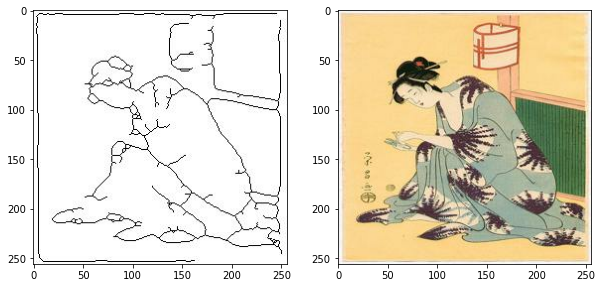

In [9]:
input_image, target_image = preprocess_image(str(DATA_PATH / 'style_1/HED/train/0.jpg'))

plt.figure(figsize=(10, 10))

plt.subplot(1, 2, 1)
plt.imshow(input_image * 0.5 + 0.5)

plt.subplot(1, 2, 2)
plt.imshow(target_image * 0.5 + 0.5)

In [10]:
len(glob(str(DATA_PATH / 'style_1/HED/train/*')))

4054

In [11]:
len(glob(str(DATA_PATH / 'style_1/HED/test/*')))

450

In [12]:
len(glob(str(DATA_PATH / 'style_2/HED/train/*')))

4438

In [13]:
len(glob(str(DATA_PATH / 'style_2/HED/test/*')))

492

<a id="section-two"></a>

## Create model (Pix2Pix)

We rely on Pix2Pix model [1] to generate Japanese paintings from sketches.

Let $x$ the input image and $y$ the generated image. Similarly to standard GAN architectures, Pix2Pix is composed of:
- a **generator** that learns a mapping from an input image to a target image ($G: x \rightarrow y$) ;
- a **discriminator** that determines whether the generated image is real of fake.

The generator is trained to produce outputs that cannot be distinguished from real images by the discriminator. At the same time, the discriminator is trained to detect the generator’s fakes (min-max objective).

It is noteworthy that Pix2Pix relies on a **conditional GAN architecture** [2] as the discriminator takes as input the generated image and the input image. Moreover, Pix2Pix uses a regularization term, the L1 distance between prediction and target, to encourages less blurring.

The conditional GAN objective function used by Pix2Pix is described below, where the noise vector $z$ is discarded and where $\lambda=100$.

$$
\begin{aligned}
\mathcal{L}_{c G A N}(G, D)=& \mathbb{E}_{x, y}[\log D(x, y)]+ \mathbb{E}_{x, z}[\log (1-D(x, G(x, z))]
\end{aligned}
$$

$$
\mathcal{L}_{L 1}(G)=\mathbb{E}_{x, y, z}\left[\|y-G(x, z)\|_{1}\right]
$$

$$
G^{*}=\arg \min _{G} \max _{D} \mathcal{L}_{c G A N}(G, D)+\lambda \mathcal{L}_{L 1}(G)
$$

---

[1] Phillip Isola, Jun-Yan Zhu, Tinghui Zhou, Alexei A. Efros. [Image-to-Image Translation with Conditional Adversarial Networks](https://phillipi.github.io/pix2pix/). 2017 CVPR.

[2] Mehdi Mirza, Simon Osindero. [Conditional Generative Adversarial Nets](https://arxiv.org/pdf/1411.1784.pdf). 2014.

In [14]:
from tensorflow.keras import Model, Sequential
from tensorflow.keras.layers import Conv2D, BatchNormalization, LeakyReLU
from tensorflow.keras.layers import Conv2DTranspose, Dropout, ReLU
from tensorflow.keras.layers import ZeroPadding2D
from tensorflow.keras.layers import Input, Concatenate
from tensorflow.keras.losses import BinaryCrossentropy

In [15]:
WEIGHTS_INITIALIZER = tf.random_normal_initializer(0, 0.02)

<a id="section-model-1"></a>

### Define submodules for `encoder` and `decoder`

In [16]:
def encoder_block(filters, batchnorm=True):
    model = Sequential()

    model.add(
        Conv2D(
            filters,
            kernel_size=4,
            strides=2,
            padding='same',
            kernel_initializer=WEIGHTS_INITIALIZER,
            use_bias=False)
    )

    if batchnorm:
        model.add(BatchNormalization())

    model.add(LeakyReLU(alpha=0.2))

    return model

In [17]:
def decoder_block(filters, dropout=False):
    model = Sequential()
    
    model.add(
        Conv2DTranspose(
            filters,
            kernel_size=4,
            strides=2,
            padding='same',
            kernel_initializer=WEIGHTS_INITIALIZER,
            use_bias=False)
    )

    model.add(BatchNormalization())

    if dropout:
        model.add(Dropout(rate=0.5))

    model.add(ReLU())

    return model

<a id="section-model-2"></a>

### Create Pix2Pix Generator

The generator architecture is based on the encoder-decoder U-Net architecture and follows the implementation details provided in section "6.1. Network architectures" of Pix2Pix original article.

The model is composed of a series of encoder blocks (`Conv2D` -> `BatchNormalization` for all except the first layer -> `LeakyReLU`) and a series of decoder blocks (`Conv2DTranspose` -> `BatchNormalization` -> `Dropout` for the first 3 layers -> `ReLU`). The last layer is a convolution to map 3 channels so that the output shape matches the input shape ($256\times256\times3$).

All the 2D convolutions have a stride of 2 and a kernel size of 4. The last activation function is `than` activation. Skip connections are added between layer $i$ in the encoder and layer $n-i$ in the decoder, where $n$ is the total number of layers. The skip connections are applied with concatenation of activations from layer $i$ to layer $n - i$.

In [18]:
class Pix2PixGenerator(Model):
    '''
    Pix2Pix Generator architecture implemented as a Keras model.

    "Image-to-Image Translation with Conditional Adversarial Networks"
    Phillip Isola, Jun-Yan Zhu, Tinghui Zhou and Alexei A. Efros
    https://arxiv.org/pdf/1611.07004.pdf
    '''
    
    def __init__(self, reg, initializer=WEIGHTS_INITIALIZER):
        super().__init__()
        
        self.reg = reg
        self.initializer = initializer
        
        self.encoder_blocks = (
            encoder_block(64, batchnorm=False),
            encoder_block(128),
            encoder_block(256),
            encoder_block(512),
            encoder_block(512),
            encoder_block(512),
            encoder_block(512),
            encoder_block(512),
        )

        self.decoder_blocks = (
            decoder_block(512, dropout=True),
            decoder_block(512, dropout=True),
            decoder_block(512, dropout=True),
            decoder_block(512),
            decoder_block(256),
            decoder_block(128),
            decoder_block(64),
        )

        self.last_layer = Conv2DTranspose(
            filters=3,
            kernel_size=4,
            strides=2,
            padding='same',
            kernel_initializer=self.initializer,
            activation='tanh'
        )
        
        self.bce = BinaryCrossentropy(from_logits=True) # use sigmoid
        
    def call(self, X):
        # X shape: (B, 256, 256, 3)
        
        skips = []
        for model in self.encoder_blocks:
            X = model(X)
            skips.append(X)

        skips = reversed(skips[:-1])
        for model, skip in zip(self.decoder_blocks, skips):
            X = model(X)
            X = Concatenate()((X, skip))

        X = self.last_layer(X)
        
        # X shape: (B, 256, 256, 3)
        return X
    
    def compute_loss(self, disc_fake_output, pred_image, target_image, lamda=100):
        labels = tf.ones_like(disc_fake_output)
        loss = self.bce(labels, disc_fake_output)

        if self.reg == 'l1':
            loss += lamda * tf.reduce_mean(tf.abs(target_image - pred_image))
        elif self.reg == 'l2':
            loss += lamda * tf.reduce_mean(tf.math.pow(target_image - pred_image, 2))

        return loss

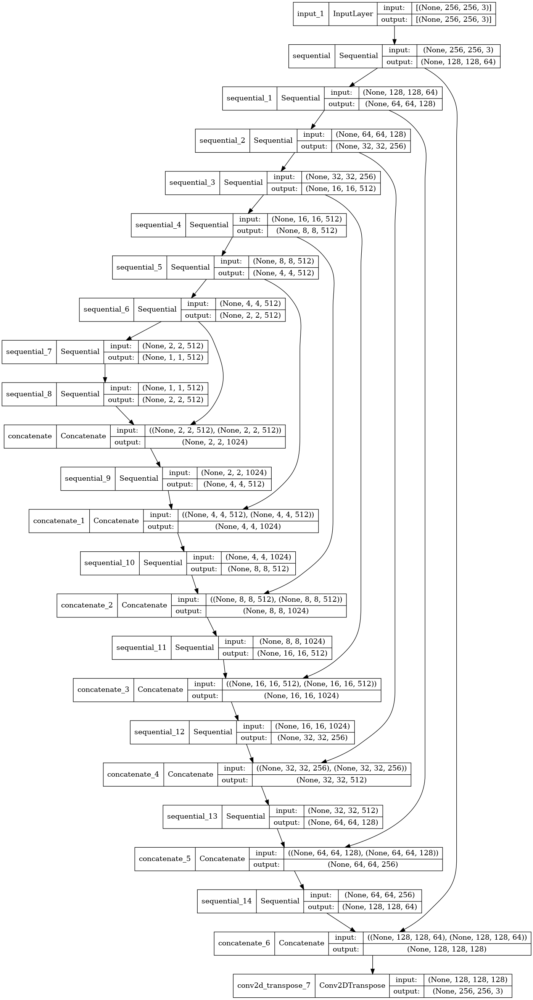

In [19]:
# Plot generator model
gen = Pix2PixGenerator(None)
x = Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3))
model_ = Model(inputs=(x,), outputs=gen.call(x))
tf.keras.utils.plot_model(model_, show_shapes=True)

<a id="section-model-3"></a>

### Create Pix2Pix Discriminator

The discriminator architecture follows the implementation details provided in section "6.1. Network architectures" of Pix2Pix original article.

The models takes as input the input image and the generated image and outputs a tensor of shape $30\times30\times1$ with values between $0$ and $1$.

The model is composed of first the concatenation of the input image and the unknown yet image. The model is then followed by a series of 3 encoder blocks (`Conv2D` with stride of 2 -> `BatchNormalization` for all except the first layer -> `LeakyReLU`). Then, the model is followed by a `ZerosPad2D` layer, a `Conv2D` with stride of 1, a `BatchNormalization` layer, a `LeakyRelu` layer, a `ZerosPad2D` layer. The final layer is a `Conv2D` with a stride of 1 and 1 filter to match the wanted tensor shape $30\times30\times1$. All the convolutions have a kernel size of 4.

In [20]:
class Pix2PixDiscriminator(Model):
    '''
    Pix2Pix Discriminator architecture implemented as a Keras model.

    "Image-to-Image Translation with Conditional Adversarial Networks"
    Phillip Isola, Jun-Yan Zhu, Tinghui Zhou and Alexei A. Efros
    https://arxiv.org/pdf/1611.07004.pdf
    '''
    
    def __init__(self, initializer=WEIGHTS_INITIALIZER):
        super().__init__()
        
        self.initializer = initializer
        
        self.encoder_block1 = encoder_block(64, batchnorm=False)
        self.encoder_block2 = encoder_block(128)
        self.encoder_block3 = encoder_block(256)
        
        self.zero_pad1 = ZeroPadding2D()
        
        self.conv1 = Conv2D(
            filters=512,
            kernel_size=4,
            strides=1,
            kernel_initializer=self.initializer,
            use_bias=False
        )

        self.batchnorm = BatchNormalization()

        self.lrelu = LeakyReLU(alpha=0.2)

        self.zero_pad2 = ZeroPadding2D()

        self.conv2 = Conv2D(
            filters=1,
            kernel_size=4,
            strides=1,
            kernel_initializer=self.initializer
        )
        
        self.bce = BinaryCrossentropy(from_logits=True) # use sigmoid
        
    def call(self, inputs):
        input_image, pred_image = inputs
        X = tf.concat((input_image, pred_image), axis=-1)
        # X shape: (B, 256, 256, 2*3)

        X = self.encoder_block1(X)
        X = self.encoder_block2(X)
        X = self.encoder_block3(X)
        X = self.zero_pad1(X)
        X = self.conv1(X)
        X = self.batchnorm(X)
        X = self.lrelu(X)
        X = self.zero_pad2(X)
        X = self.conv2(X)
        
        # X shape: (B, 30, 30, 1)
        return X
        
    def compute_loss(self, disc_real_output, disc_fake_output):
        real_labels = tf.ones_like(disc_real_output)
        real_loss = self.bce(real_labels, disc_real_output)

        fake_labels = tf.zeros_like(disc_fake_output)
        fake_loss = self.bce(fake_labels, disc_fake_output)

        return real_loss + fake_loss

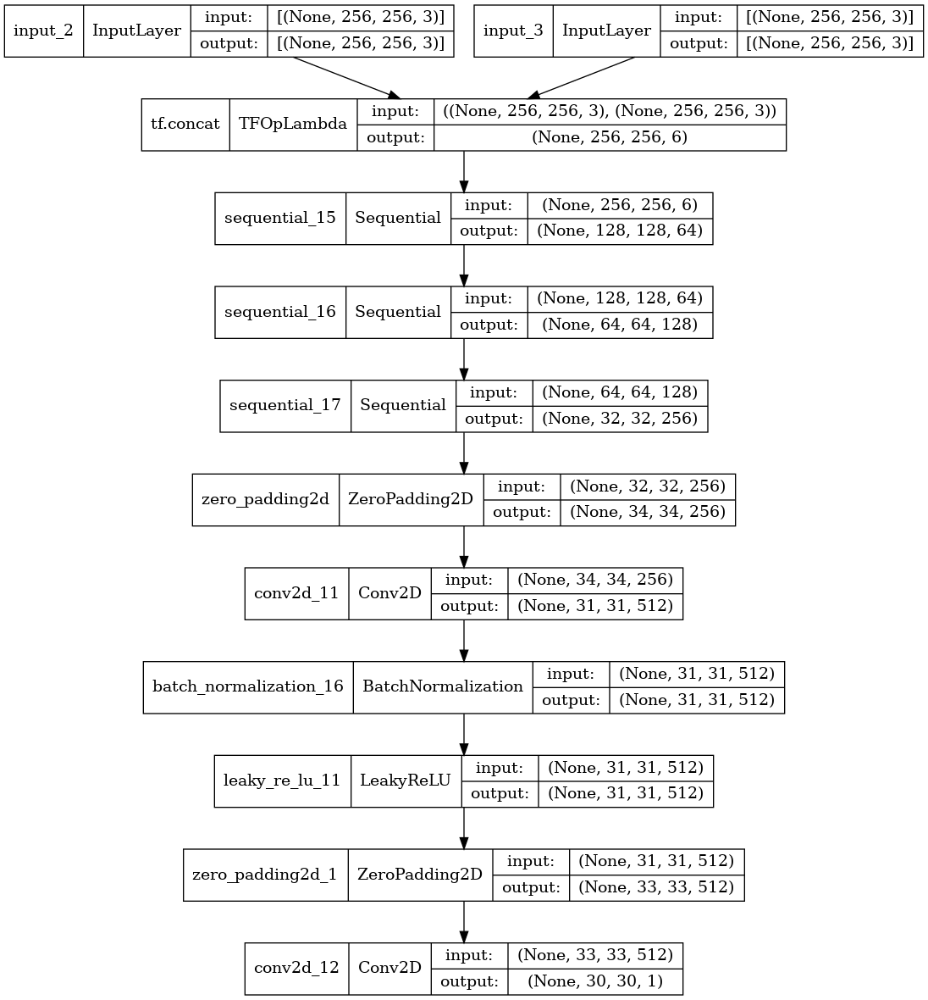

In [21]:
# Plot discriminator model
disc = Pix2PixDiscriminator()
x1 = Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3))
x2 = Input(shape=(IMG_HEIGHT, IMG_WIDTH, 3))
model_ = Model(inputs=(x1, x2), outputs=disc.call((x1, x2)))
tf.keras.utils.plot_model(model_, show_shapes=True)

<a id="section-model-4"></a>

### Pix2Pix model

In [31]:
class Pix2Pix(Model):
    '''
    Pix2Pix architecture implemented as a Keras model.

    "Image-to-Image Translation with Conditional Adversarial Networks"
    Phillip Isola, Jun-Yan Zhu, Tinghui Zhou and Alexei A. Efros
    https://arxiv.org/pdf/1611.07004.pdf
    '''
    
    def __init__(self, reg='l1'):
        super().__init__()

        self.generator = Pix2PixGenerator(reg)
        self.discriminator = Pix2PixDiscriminator()
        
    def call(self, X):
        return self.generator(X)
    
    def compile(self, generator_opt, discriminator_opt):
        super().compile()
        
        self.generator_opt = generator_opt
        self.discriminator_opt = discriminator_opt
    
    @tf.function
    def train_step(self, data):
        input_image, target_image = data
        
        input_image.set_shape((None, None, None, 3))
        target_image.set_shape((None, None, None, 3))
        
        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            disc_real_output = self.discriminator((input_image, target_image), training=True)

            pred_image = self.generator(input_image, training=True)
            disc_fake_output = self.discriminator((input_image, pred_image), training=True)

            gen_loss = self.generator.compute_loss(disc_fake_output, pred_image, target_image)
            disc_loss = self.discriminator.compute_loss(disc_real_output, disc_fake_output)

        gen_grads = gen_tape.gradient(gen_loss, self.generator.trainable_variables)
        self.generator_opt.apply_gradients(zip(gen_grads, self.generator.trainable_variables))

        disc_grads = disc_tape.gradient(disc_loss, self.discriminator.trainable_variables)
        self.discriminator_opt.apply_gradients(zip(disc_grads, self.discriminator.trainable_variables))
        
        metrics = { 'gen_loss': gen_loss, 'disc_loss': disc_loss }
        return metrics

In [32]:
from tensorflow.keras.optimizers import Adam

def create_model(reg='l1'):
    model = Pix2Pix(reg=reg)
    model.compile(
        generator_opt=Adam(learning_rate=0.0002, beta_1=0.5),
        discriminator_opt=Adam(learning_rate=0.0002, beta_1=0.5)
    )
    return model

<a id="section-three"></a>

## Trainings

<a id="section-trainings-1"></a>

### Create callbacks

In [33]:
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.callbacks import TensorBoard

In [34]:
def plot_results(model, input_image, target_image):
    pred_image = model(input_image, training=True)

    plt.figure(figsize=(10, 10))

    plt.subplot(1, 3, 1)
    plt.title('Input')
    plt.imshow(input_image[0] * 0.5 + 0.5)

    plt.subplot(1, 3, 2)
    plt.title('Predicted')
    plt.imshow(pred_image[0] * 0.5 + 0.5)

    plt.subplot(1, 3, 3)
    plt.title('Target')
    plt.imshow(target_image[0] * 0.5 + 0.5)

    plt.show()

class PlotResultsCallback(Callback):

    def __init__(self, ds_test, monitor):
        super().__init__()

        self.monitor = monitor
        self.best_metric = float('inf')
        
        self.input_image, self.target_image = next(iter(ds_test.take(1)))
        
    def on_epoch_begin(self, epoch, logs):
        if epoch == 0:
            plot_results(self.model, self.input_image, self.target_image)
        
    def on_epoch_end(self, epoch, logs):
        show = (epoch < 5)
        
        if logs[self.monitor] < self.best_metric:
            self.best_metric = logs[self.monitor]
            show = True
            
        if show:
            plot_results(self.model, self.input_image, self.target_image)

In [35]:
from tensorflow.keras.applications import InceptionV3
from scipy.linalg import sqrtm

def compute_fid(model, ds_test,inception_model):
    # Extract embeddings
    target_embeddings, pred_embeddings = [], []
    for input_image, target_image in ds_test:
        pred_image = model(input_image, training=True)
        target_embeddings.extend(inception_model.predict(target_image))
        pred_embeddings.extend(inception_model.predict(pred_image))
    target_embeddings = np.array(target_embeddings)
    pred_embeddings = np.array(pred_embeddings)
    
    # Compute FID
    mu1, sigma1 = target_embeddings.mean(axis=0), np.cov(target_embeddings, rowvar=False)
    mu2, sigma2 = pred_embeddings.mean(axis=0), np.cov(pred_embeddings,  rowvar=False)

    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean): covmean = covmean.real
    
    fid = np.sum((mu1 - mu2) ** 2) + np.trace(sigma1 + sigma2 - 2 * covmean)
    return fid

class FIDMetricCallback(Callback):

    def __init__(self, ds_test):
        super().__init__()

        self.ds_test = ds_test
        self.inception_model = InceptionV3(include_top=False, weights='imagenet', pooling='avg')

    def on_epoch_end(self, epoch, logs):
        fid = compute_fid(self.model, self.ds_test, self.inception_model)
        print('FID:', fid)
        logs.update({ 'fid': fid })

In [36]:
def create_callbacks(name, ds_test, monitor='fid'):
    callbacks = [
        FIDMetricCallback(ds_test),
        ModelCheckpoint(
            filepath=CHECKPOINT_DIR + '/' + name + '/training',
            monitor=monitor,
            mode='min',
            save_best_only=True,
            save_weights_only=True,
            verbose=1
        ),
        # TensorBoard(log_dir=LOG_DIR, histogram_freq=1),
        EarlyStopping(monitor=monitor, mode='min', patience=PATIENCE),
        PlotResultsCallback(ds_test, monitor)
    ]
    return callbacks

In [37]:
def train_model(name, ds_train, ds_test, reg='l1'):
    model = create_model(reg)
    history = model.fit(
        ds_train,
        epochs=MAX_NB_EPOCHS,
        callbacks=create_callbacks(name, ds_test)
    )
    np.save(CHECKPOINT_DIR + '/' + name + '/history.npy', history.history)

<a id="section-trainings-2"></a>

### Trainings: different regularization methods *(none, l1, l2)*

Epoch 1/100


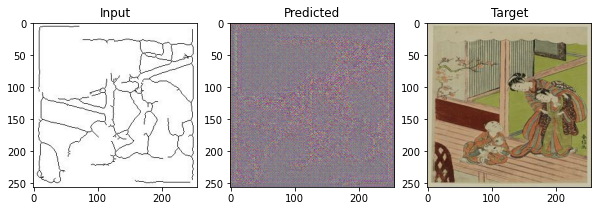

1014/1014 [==============================] - 125s 118ms/step - gen_loss: 0.9408 - disc_loss: 1.2477
FID: 491.1328197721761

Epoch 00001: fid improved from inf to 491.13282, saving model to ./checkpoints/style_1_hed/training


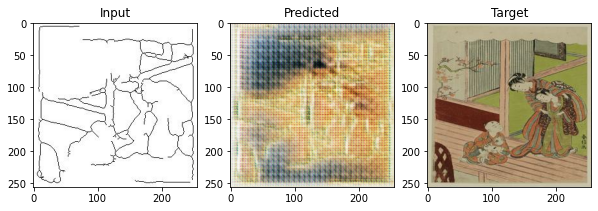

Epoch 2/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.1201 - disc_loss: 1.0897
FID: 485.9802015741628

Epoch 00002: fid improved from 491.13282 to 485.98020, saving model to ./checkpoints/style_1_hed/training


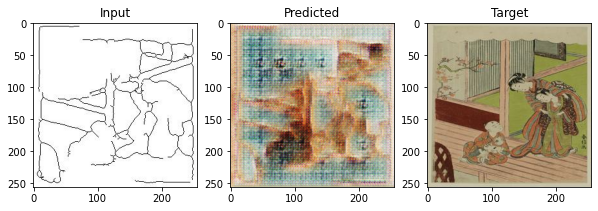

Epoch 3/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.1582 - disc_loss: 1.0792
FID: 387.5729699273943

Epoch 00003: fid improved from 485.98020 to 387.57297, saving model to ./checkpoints/style_1_hed/training


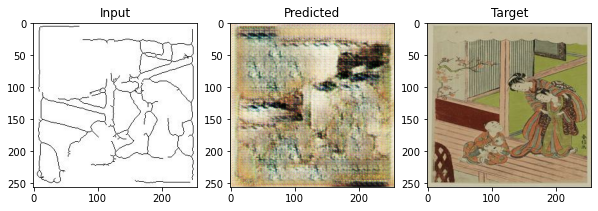

Epoch 4/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.2978 - disc_loss: 0.9877
FID: 263.864447491029

Epoch 00004: fid improved from 387.57297 to 263.86445, saving model to ./checkpoints/style_1_hed/training


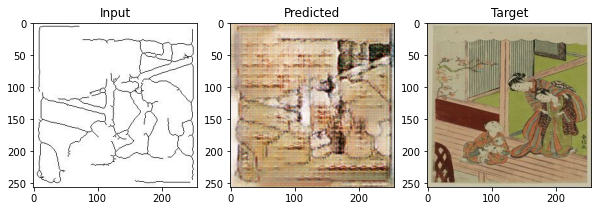

Epoch 5/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.3757 - disc_loss: 0.9497
FID: 262.8406202960366

Epoch 00005: fid improved from 263.86445 to 262.84062, saving model to ./checkpoints/style_1_hed/training


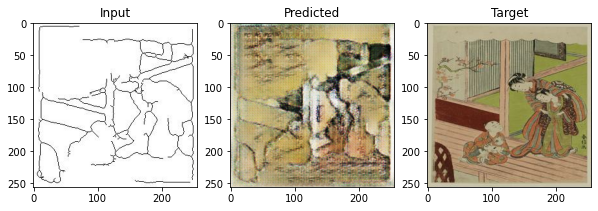

Epoch 6/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 1.3492 - disc_loss: 0.9732
FID: 209.47618961662374

Epoch 00006: fid improved from 262.84062 to 209.47619, saving model to ./checkpoints/style_1_hed/training


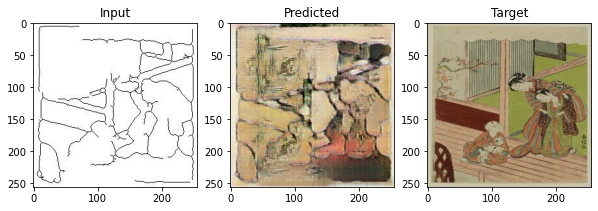

Epoch 7/100
1014/1014 [==============================] - 120s 119ms/step - gen_loss: 1.3984 - disc_loss: 0.9601
FID: 272.29688524258495

Epoch 00007: fid did not improve from 209.47619
Epoch 8/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 1.4583 - disc_loss: 0.9237
FID: 249.90558080835413

Epoch 00008: fid did not improve from 209.47619
Epoch 9/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 1.4508 - disc_loss: 0.9349
FID: 233.9488344601476

Epoch 00009: fid did not improve from 209.47619
Epoch 10/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 1.4537 - disc_loss: 0.9307
FID: 226.37376394889912

Epoch 00010: fid did not improve from 209.47619
Epoch 11/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.4744 - disc_loss: 0.9320
FID: 233.815402321593

Epoch 00011: fid did not improve from 209.47619
Epoch 12/100
1014/1014 [==============================] - 120s 118ms/step - 

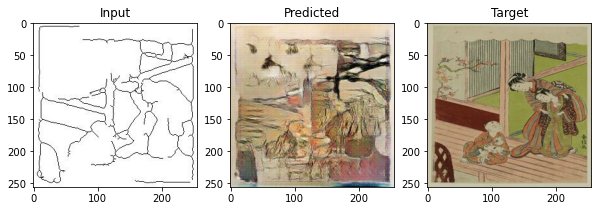

Epoch 14/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.6420 - disc_loss: 0.8567
FID: 256.77003768129094

Epoch 00014: fid did not improve from 202.67060
Epoch 15/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 1.6835 - disc_loss: 0.8418
FID: 201.89095340316572

Epoch 00015: fid improved from 202.67060 to 201.89095, saving model to ./checkpoints/style_1_hed/training


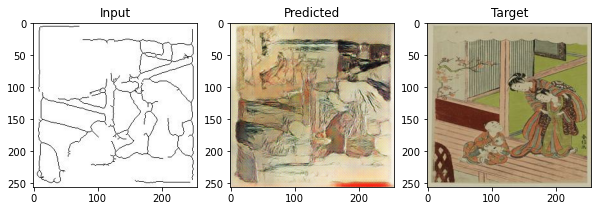

Epoch 16/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.7150 - disc_loss: 0.8244
FID: 190.7463800867536

Epoch 00016: fid improved from 201.89095 to 190.74638, saving model to ./checkpoints/style_1_hed/training


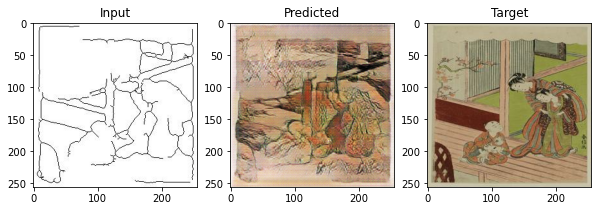

Epoch 17/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.8056 - disc_loss: 0.8007
FID: 220.86596258777675

Epoch 00017: fid did not improve from 190.74638
Epoch 18/100
1014/1014 [==============================] - 120s 119ms/step - gen_loss: 1.8204 - disc_loss: 0.8013
FID: 199.66140522591377

Epoch 00018: fid did not improve from 190.74638
Epoch 19/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.8583 - disc_loss: 0.7699
FID: 175.84504404214172

Epoch 00019: fid improved from 190.74638 to 175.84504, saving model to ./checkpoints/style_1_hed/training


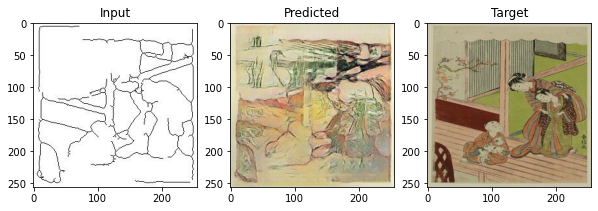

Epoch 20/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.9177 - disc_loss: 0.7504
FID: 195.84125005696782

Epoch 00020: fid did not improve from 175.84504
Epoch 21/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 1.9629 - disc_loss: 0.7289
FID: 191.88134335586466

Epoch 00021: fid did not improve from 175.84504
Epoch 22/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 2.1096 - disc_loss: 0.6880
FID: 192.18583449994225

Epoch 00022: fid did not improve from 175.84504
Epoch 23/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 2.1892 - disc_loss: 0.6568
FID: 224.4462839750646

Epoch 00023: fid did not improve from 175.84504
Epoch 24/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 2.3511 - disc_loss: 0.6035
FID: 195.52015544246586

Epoch 00024: fid did not improve from 175.84504
Epoch 25/100
1014/1014 [==============================] - 120s 118ms/st

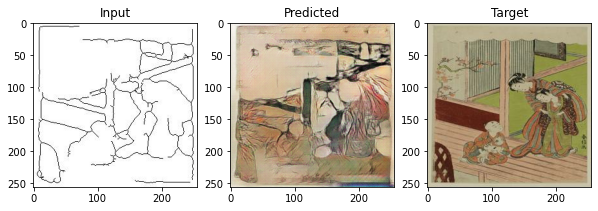

Epoch 30/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 3.4129 - disc_loss: 0.3570
FID: 224.76068565498673

Epoch 00030: fid did not improve from 168.92089
Epoch 31/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 3.3723 - disc_loss: 0.3875
FID: 220.51381539227182

Epoch 00031: fid did not improve from 168.92089
Epoch 32/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 3.5003 - disc_loss: 0.3429
FID: 215.08545954744548

Epoch 00032: fid did not improve from 168.92089
Epoch 33/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 3.6894 - disc_loss: 0.3115
FID: 216.8126203391758

Epoch 00033: fid did not improve from 168.92089
Epoch 34/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 3.7721 - disc_loss: 0.2970
FID: 176.2616863056363

Epoch 00034: fid did not improve from 168.92089
Epoch 35/100
1014/1014 [==============================] - 121s 119ms/ste

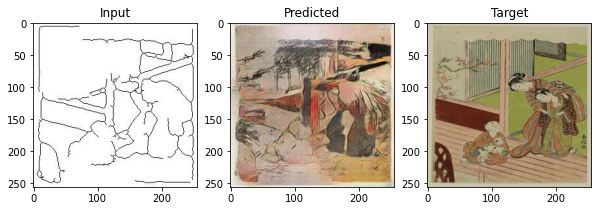

Epoch 42/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 4.0073 - disc_loss: 0.2933
FID: 159.04802631314232

Epoch 00042: fid did not improve from 145.38428
Epoch 43/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 3.8840 - disc_loss: 0.3191
FID: 163.07806412242093

Epoch 00043: fid did not improve from 145.38428
Epoch 44/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 3.8235 - disc_loss: 0.2992
FID: 154.54723329515227

Epoch 00044: fid did not improve from 145.38428
Epoch 45/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 3.8126 - disc_loss: 0.3162
FID: 158.75547287563265

Epoch 00045: fid did not improve from 145.38428
Epoch 46/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 3.7661 - disc_loss: 0.3070
FID: 157.24727273606499

Epoch 00046: fid did not improve from 145.38428
Epoch 47/100
1014/1014 [==============================] - 120s 118ms/s

In [29]:
train_model('style_1_hed', ds_style_1_hed_train, ds_style_1_hed_test, reg=None)

Epoch 1/100


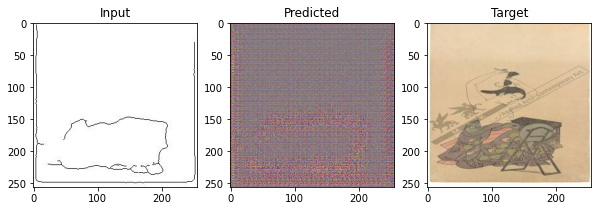

1014/1014 [==============================] - 124s 119ms/step - gen_loss: 32.3827 - disc_loss: 0.5830
FID: 251.41103571883616

Epoch 00001: fid improved from inf to 251.41104, saving model to ./checkpoints/style_1_hed_l1/training


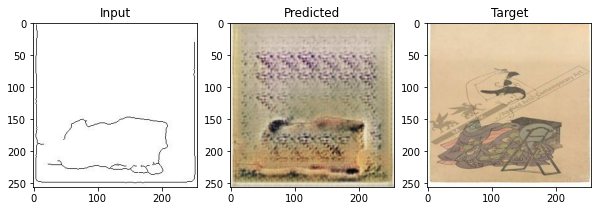

Epoch 2/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 32.6014 - disc_loss: 0.6437
FID: 221.65247463925144

Epoch 00002: fid improved from 251.41104 to 221.65247, saving model to ./checkpoints/style_1_hed_l1/training


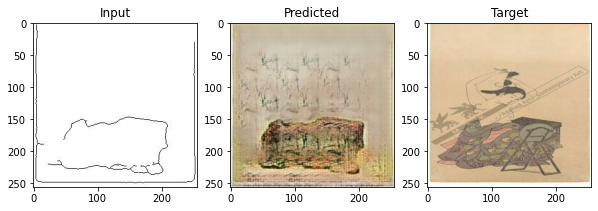

Epoch 3/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 32.3864 - disc_loss: 0.7015
FID: 212.2042134907436

Epoch 00003: fid improved from 221.65247 to 212.20421, saving model to ./checkpoints/style_1_hed_l1/training


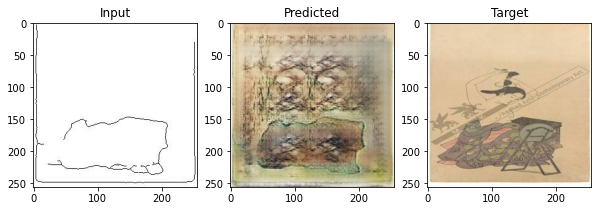

Epoch 4/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 31.9395 - disc_loss: 0.7337
FID: 222.61030026484494

Epoch 00004: fid did not improve from 212.20421


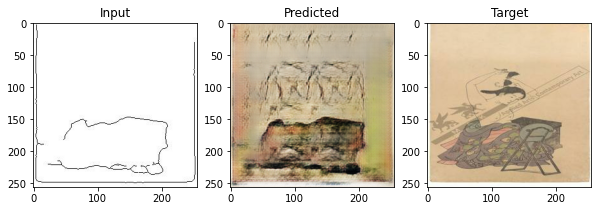

Epoch 5/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 31.4290 - disc_loss: 0.7317
FID: 220.59893858611517

Epoch 00005: fid did not improve from 212.20421


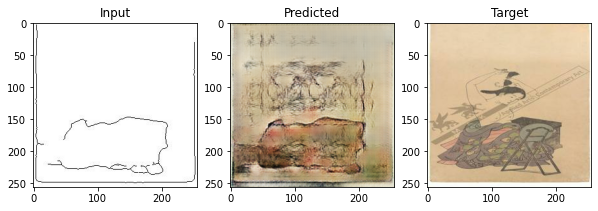

Epoch 6/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 30.8626 - disc_loss: 0.7193
FID: 215.30706395215955

Epoch 00006: fid did not improve from 212.20421
Epoch 7/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 30.0828 - disc_loss: 0.7378
FID: 225.51485002113284

Epoch 00007: fid did not improve from 212.20421
Epoch 8/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 29.1146 - disc_loss: 0.7271
FID: 221.7530050056059

Epoch 00008: fid did not improve from 212.20421
Epoch 9/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 28.0560 - disc_loss: 0.7218
FID: 228.10425990839582

Epoch 00009: fid did not improve from 212.20421
Epoch 10/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 27.1943 - disc_loss: 0.7312
FID: 217.18859988579237

Epoch 00010: fid did not improve from 212.20421
Epoch 11/100
1014/1014 [==============================] - 120s 118ms/s

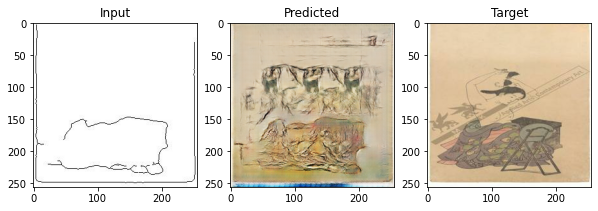

Epoch 12/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 25.8886 - disc_loss: 0.7183
FID: 182.28000080038146

Epoch 00012: fid improved from 191.77763 to 182.28000, saving model to ./checkpoints/style_1_hed_l1/training


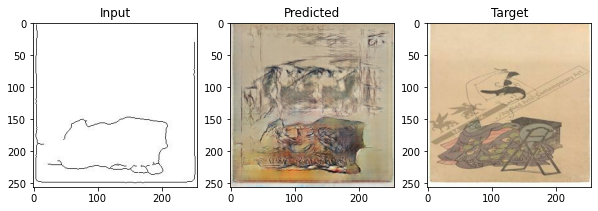

Epoch 13/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 25.3176 - disc_loss: 0.7300
FID: 184.65992709032838

Epoch 00013: fid did not improve from 182.28000
Epoch 14/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 24.8901 - disc_loss: 0.7299
FID: 187.91377212180907

Epoch 00014: fid did not improve from 182.28000
Epoch 15/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 24.4682 - disc_loss: 0.7419
FID: 191.93062491928413

Epoch 00015: fid did not improve from 182.28000
Epoch 16/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 24.0287 - disc_loss: 0.7364
FID: 177.3314786497843

Epoch 00016: fid improved from 182.28000 to 177.33148, saving model to ./checkpoints/style_1_hed_l1/training


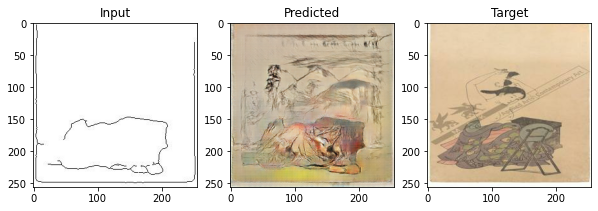

Epoch 17/100
1014/1014 [==============================] - 120s 119ms/step - gen_loss: 23.6351 - disc_loss: 0.7325
FID: 168.44236211466045

Epoch 00017: fid improved from 177.33148 to 168.44236, saving model to ./checkpoints/style_1_hed_l1/training


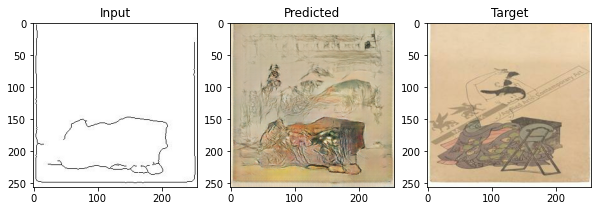

Epoch 18/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 23.3672 - disc_loss: 0.7322
FID: 172.67126102342843

Epoch 00018: fid did not improve from 168.44236
Epoch 19/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 22.9652 - disc_loss: 0.7354
FID: 163.56695257783082

Epoch 00019: fid improved from 168.44236 to 163.56695, saving model to ./checkpoints/style_1_hed_l1/training


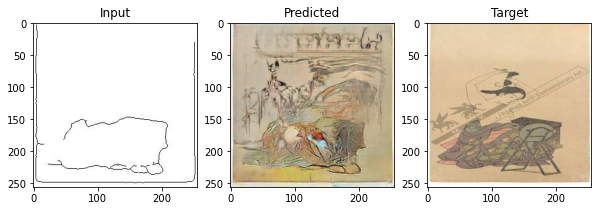

Epoch 20/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 22.7355 - disc_loss: 0.7186
FID: 163.2623881111463

Epoch 00020: fid improved from 163.56695 to 163.26239, saving model to ./checkpoints/style_1_hed_l1/training


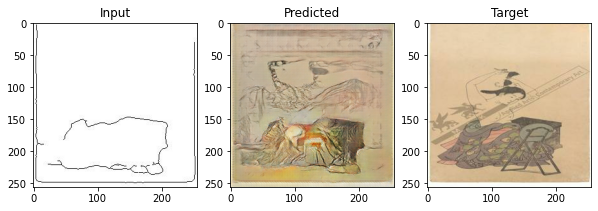

Epoch 21/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 22.4210 - disc_loss: 0.7375
FID: 140.93161077231872

Epoch 00021: fid improved from 163.26239 to 140.93161, saving model to ./checkpoints/style_1_hed_l1/training


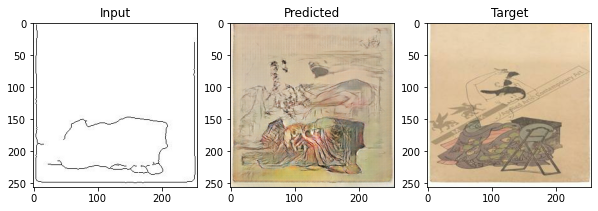

Epoch 22/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 22.1237 - disc_loss: 0.7374
FID: 151.13347166641745

Epoch 00022: fid did not improve from 140.93161
Epoch 23/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 21.8585 - disc_loss: 0.7426
FID: 142.58014149227915

Epoch 00023: fid did not improve from 140.93161
Epoch 24/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 21.6535 - disc_loss: 0.7503
FID: 134.80295592940485

Epoch 00024: fid improved from 140.93161 to 134.80296, saving model to ./checkpoints/style_1_hed_l1/training


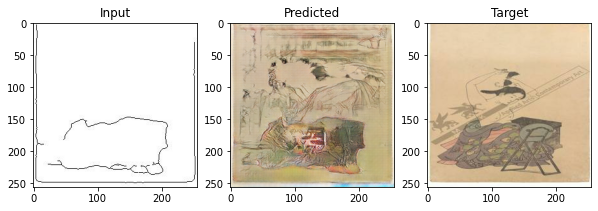

Epoch 25/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 21.4644 - disc_loss: 0.7375
FID: 137.27718389142615

Epoch 00025: fid did not improve from 134.80296
Epoch 26/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 21.2013 - disc_loss: 0.7346
FID: 130.61170286075782

Epoch 00026: fid improved from 134.80296 to 130.61170, saving model to ./checkpoints/style_1_hed_l1/training


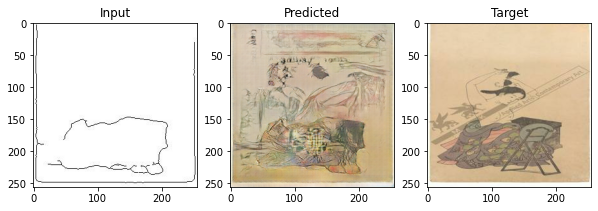

Epoch 27/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 21.0436 - disc_loss: 0.7471
FID: 133.8502363209264

Epoch 00027: fid did not improve from 130.61170
Epoch 28/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 20.8446 - disc_loss: 0.7450
FID: 148.18194825437408

Epoch 00028: fid did not improve from 130.61170
Epoch 29/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 20.6665 - disc_loss: 0.7407
FID: 129.68624922908543

Epoch 00029: fid improved from 130.61170 to 129.68625, saving model to ./checkpoints/style_1_hed_l1/training


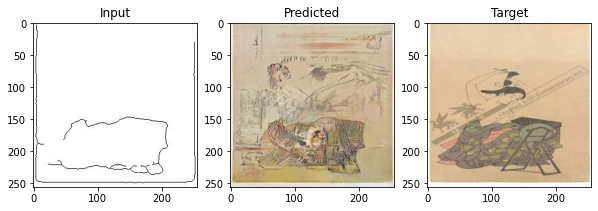

Epoch 30/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 20.5442 - disc_loss: 0.7296
FID: 134.80124485855671

Epoch 00030: fid did not improve from 129.68625
Epoch 31/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 20.3989 - disc_loss: 0.7376
FID: 125.16196623162554

Epoch 00031: fid improved from 129.68625 to 125.16197, saving model to ./checkpoints/style_1_hed_l1/training


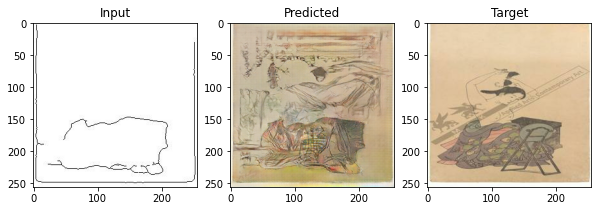

Epoch 32/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 20.2410 - disc_loss: 0.7428
FID: 131.9754820562823

Epoch 00032: fid did not improve from 125.16197
Epoch 33/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 20.0967 - disc_loss: 0.7369
FID: 141.31173197112375

Epoch 00033: fid did not improve from 125.16197
Epoch 34/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 20.0109 - disc_loss: 0.7231
FID: 131.68876089790263

Epoch 00034: fid did not improve from 125.16197
Epoch 35/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 19.9434 - disc_loss: 0.6984
FID: 133.32617053399537

Epoch 00035: fid did not improve from 125.16197
Epoch 36/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 19.8296 - disc_loss: 0.7157
FID: 132.07328861716567

Epoch 00036: fid did not improve from 125.16197
Epoch 37/100
1014/1014 [==============================] - 121s 119

In [30]:
train_model('style_1_hed_l1', ds_style_1_hed_train, ds_style_1_hed_test, reg='l1')

Epoch 1/100


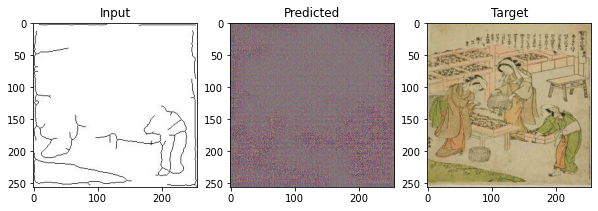

1014/1014 [==============================] - 124s 119ms/step - gen_loss: 18.0197 - disc_loss: 0.5543
FID: 256.76922458205877

Epoch 00001: fid improved from inf to 256.76922, saving model to ./checkpoints/style_1_hed_l2/training


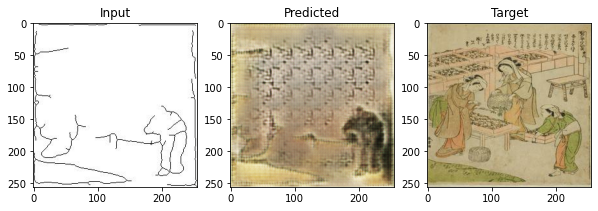

Epoch 2/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 18.3233 - disc_loss: 0.6485
FID: 218.68197297676144

Epoch 00002: fid improved from 256.76922 to 218.68197, saving model to ./checkpoints/style_1_hed_l2/training


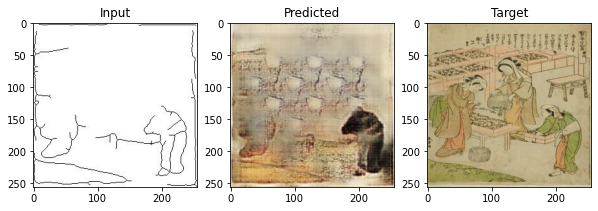

Epoch 3/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 18.0878 - disc_loss: 0.6790
FID: 209.63850220201795

Epoch 00003: fid improved from 218.68197 to 209.63850, saving model to ./checkpoints/style_1_hed_l2/training


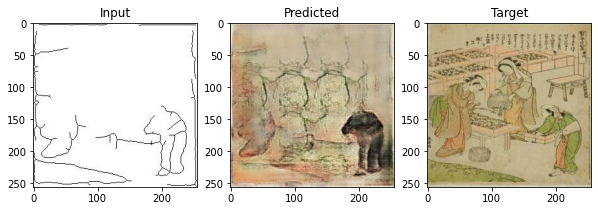

Epoch 4/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 17.8428 - disc_loss: 0.7036
FID: 231.55004118389002

Epoch 00004: fid did not improve from 209.63850


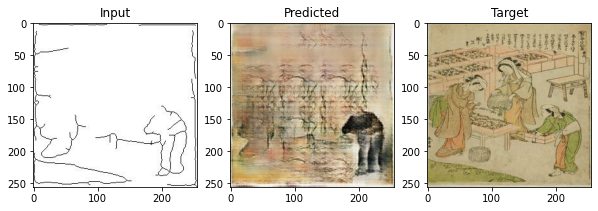

Epoch 5/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 17.3608 - disc_loss: 0.7274
FID: 213.2815081841706

Epoch 00005: fid did not improve from 209.63850


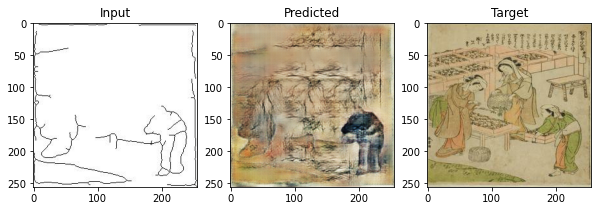

Epoch 6/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 16.7401 - disc_loss: 0.7444
FID: 229.62123745726393

Epoch 00006: fid did not improve from 209.63850
Epoch 7/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 15.9686 - disc_loss: 0.7557
FID: 224.59816271113903

Epoch 00007: fid did not improve from 209.63850
Epoch 8/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 15.2273 - disc_loss: 0.7616
FID: 233.13096365297847

Epoch 00008: fid did not improve from 209.63850
Epoch 9/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 14.3605 - disc_loss: 0.7777
FID: 233.3677234754469

Epoch 00009: fid did not improve from 209.63850
Epoch 10/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 13.5949 - disc_loss: 0.7872
FID: 212.00817520597187

Epoch 00010: fid did not improve from 209.63850
Epoch 11/100
1014/1014 [==============================] - 120s 119ms/s

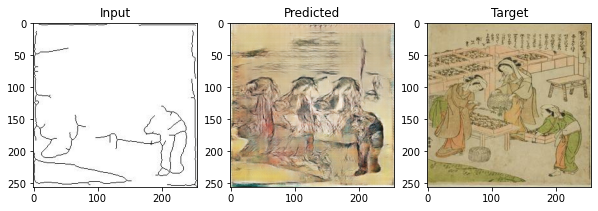

Epoch 12/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 12.4749 - disc_loss: 0.7964
FID: 195.7670448794975

Epoch 00012: fid improved from 200.90564 to 195.76704, saving model to ./checkpoints/style_1_hed_l2/training


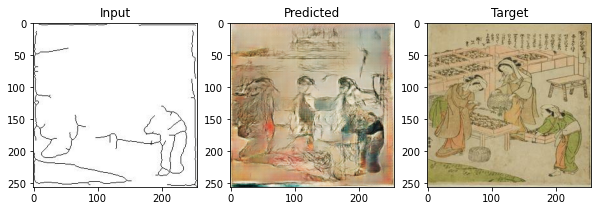

Epoch 13/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 12.0520 - disc_loss: 0.8038
FID: 192.18838315770492

Epoch 00013: fid improved from 195.76704 to 192.18838, saving model to ./checkpoints/style_1_hed_l2/training


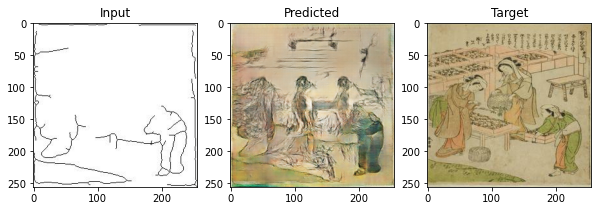

Epoch 14/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 11.6287 - disc_loss: 0.8041
FID: 174.02659899202592

Epoch 00014: fid improved from 192.18838 to 174.02660, saving model to ./checkpoints/style_1_hed_l2/training


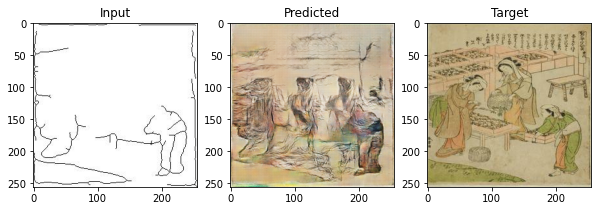

Epoch 15/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 11.2400 - disc_loss: 0.8089
FID: 180.83466227452564

Epoch 00015: fid did not improve from 174.02660
Epoch 16/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 11.0192 - disc_loss: 0.8098
FID: 193.17463993259403

Epoch 00016: fid did not improve from 174.02660
Epoch 17/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 10.7503 - disc_loss: 0.8275
FID: 179.25962130300772

Epoch 00017: fid did not improve from 174.02660
Epoch 18/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 10.5172 - disc_loss: 0.8161
FID: 155.01685056970263

Epoch 00018: fid improved from 174.02660 to 155.01685, saving model to ./checkpoints/style_1_hed_l2/training


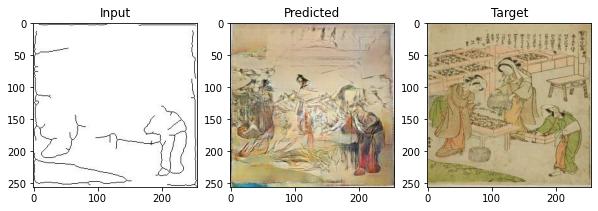

Epoch 19/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 10.3308 - disc_loss: 0.8139
FID: 163.62435250362765

Epoch 00019: fid did not improve from 155.01685
Epoch 20/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 10.1071 - disc_loss: 0.8160
FID: 149.30896451076381

Epoch 00020: fid improved from 155.01685 to 149.30896, saving model to ./checkpoints/style_1_hed_l2/training


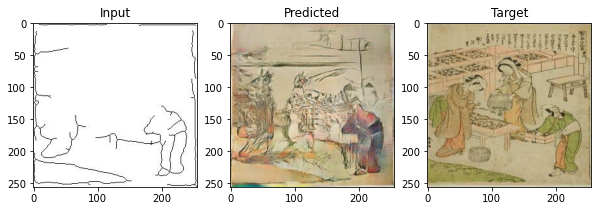

Epoch 21/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 9.9139 - disc_loss: 0.8192
FID: 154.93587142887623

Epoch 00021: fid did not improve from 149.30896
Epoch 22/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 9.7680 - disc_loss: 0.8123
FID: 164.3774424896254

Epoch 00022: fid did not improve from 149.30896
Epoch 23/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 9.6550 - disc_loss: 0.8113
FID: 158.14933635356536

Epoch 00023: fid did not improve from 149.30896
Epoch 24/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 9.4747 - disc_loss: 0.8186
FID: 147.74504577583758

Epoch 00024: fid improved from 149.30896 to 147.74505, saving model to ./checkpoints/style_1_hed_l2/training


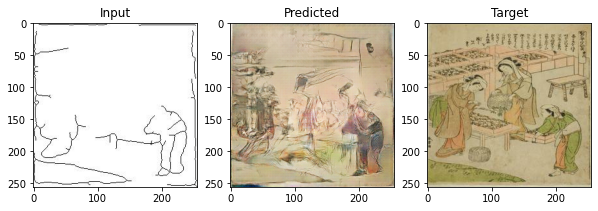

Epoch 25/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 9.3598 - disc_loss: 0.8163
FID: 142.0289807859116

Epoch 00025: fid improved from 147.74505 to 142.02898, saving model to ./checkpoints/style_1_hed_l2/training


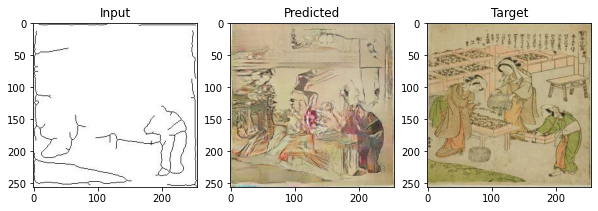

Epoch 26/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 9.2191 - disc_loss: 0.8316
FID: 144.01389913794924

Epoch 00026: fid did not improve from 142.02898
Epoch 27/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 9.1559 - disc_loss: 0.8154
FID: 149.68059384877085

Epoch 00027: fid did not improve from 142.02898
Epoch 28/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 9.0130 - disc_loss: 0.8212
FID: 143.14331903595604

Epoch 00028: fid did not improve from 142.02898
Epoch 29/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.9387 - disc_loss: 0.8217
FID: 141.0513622057958

Epoch 00029: fid improved from 142.02898 to 141.05136, saving model to ./checkpoints/style_1_hed_l2/training


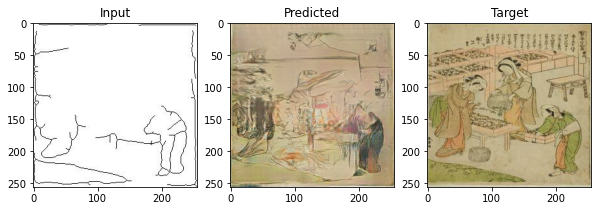

Epoch 30/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.8402 - disc_loss: 0.8071
FID: 142.76796801998884

Epoch 00030: fid did not improve from 141.05136
Epoch 31/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.7830 - disc_loss: 0.8158
FID: 135.45970045359752

Epoch 00031: fid improved from 141.05136 to 135.45970, saving model to ./checkpoints/style_1_hed_l2/training


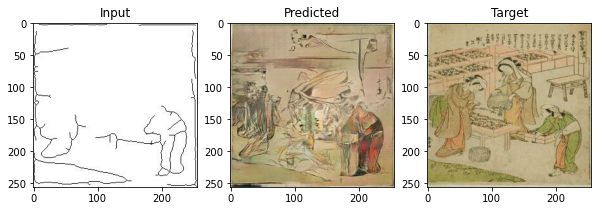

Epoch 32/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.7039 - disc_loss: 0.8034
FID: 132.88401252590774

Epoch 00032: fid improved from 135.45970 to 132.88401, saving model to ./checkpoints/style_1_hed_l2/training


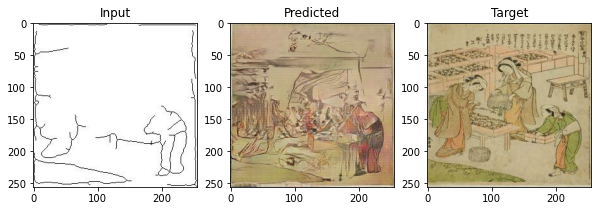

Epoch 33/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.6350 - disc_loss: 0.8133
FID: 131.2856071318651

Epoch 00033: fid improved from 132.88401 to 131.28561, saving model to ./checkpoints/style_1_hed_l2/training


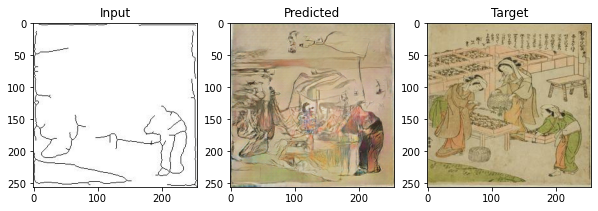

Epoch 34/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.5910 - disc_loss: 0.8084
FID: 133.24727206540985

Epoch 00034: fid did not improve from 131.28561
Epoch 35/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.5613 - disc_loss: 0.7957
FID: 137.073747958908

Epoch 00035: fid did not improve from 131.28561
Epoch 36/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.5021 - disc_loss: 0.7780
FID: 143.2320442320304

Epoch 00036: fid did not improve from 131.28561
Epoch 37/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.5061 - disc_loss: 0.8044
FID: 133.1407360471553

Epoch 00037: fid did not improve from 131.28561
Epoch 38/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.4656 - disc_loss: 0.7562
FID: 124.04650437206286

Epoch 00038: fid improved from 131.28561 to 124.04650, saving model to ./checkpoints/style_1_hed_l2/training


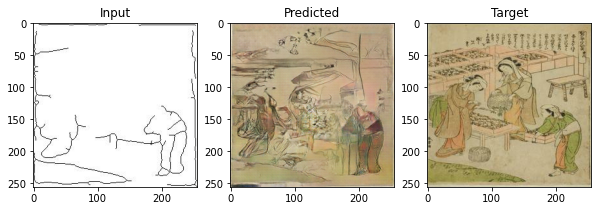

Epoch 39/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.4866 - disc_loss: 0.7561
FID: 128.32400582413499

Epoch 00039: fid did not improve from 124.04650
Epoch 40/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.4745 - disc_loss: 0.7467
FID: 124.75957803992492

Epoch 00040: fid did not improve from 124.04650
Epoch 41/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.5042 - disc_loss: 0.7053
FID: 128.10359679683998

Epoch 00041: fid did not improve from 124.04650
Epoch 42/100
1014/1014 [==============================] - 121s 119ms/step - gen_loss: 8.5592 - disc_loss: 0.6853
FID: 124.52807169702317

Epoch 00042: fid did not improve from 124.04650
Epoch 43/100
1014/1014 [==============================] - 120s 118ms/step - gen_loss: 8.8942 - disc_loss: 0.5754
FID: 131.97608041432395

Epoch 00043: fid did not improve from 124.04650
Epoch 44/100
1014/1014 [==============================] - 120s 119ms/s

In [31]:
train_model('style_1_hed_l2', ds_style_1_hed_train, ds_style_1_hed_test, reg='l2')

<a id="section-trainings-3"></a>

### Trainings: different edge extraction techniques

Epoch 1/100


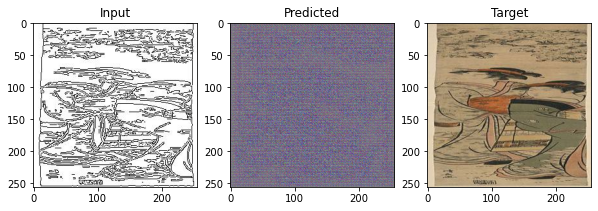

1013/1013 [==============================] - 125s 120ms/step - gen_loss: 31.7630 - disc_loss: 0.6492
FID: 253.14747371659132

Epoch 00001: fid improved from inf to 253.14747, saving model to ./checkpoints/style_1_canny_l1/training


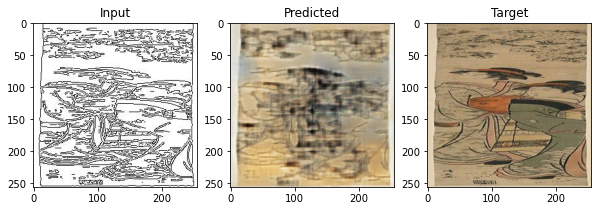

Epoch 2/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 31.6663 - disc_loss: 0.6051
FID: 231.94611614167758

Epoch 00002: fid improved from 253.14747 to 231.94612, saving model to ./checkpoints/style_1_canny_l1/training


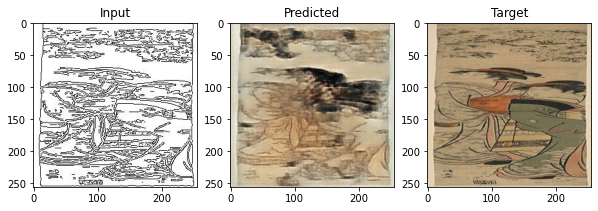

Epoch 3/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 30.9963 - disc_loss: 0.7156
FID: 210.67193343383818

Epoch 00003: fid improved from 231.94612 to 210.67193, saving model to ./checkpoints/style_1_canny_l1/training


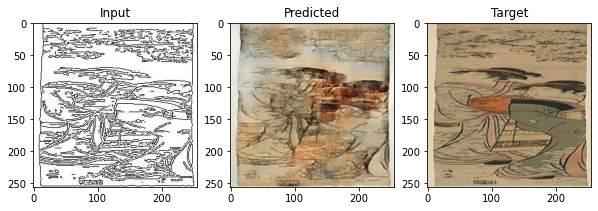

Epoch 4/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 30.4283 - disc_loss: 0.7231
FID: 201.23251763926658

Epoch 00004: fid improved from 210.67193 to 201.23252, saving model to ./checkpoints/style_1_canny_l1/training


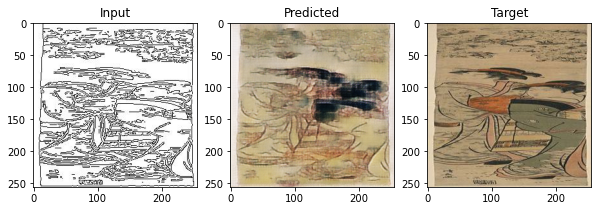

Epoch 5/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 29.8770 - disc_loss: 0.7428
FID: 185.8582092833886

Epoch 00005: fid improved from 201.23252 to 185.85821, saving model to ./checkpoints/style_1_canny_l1/training


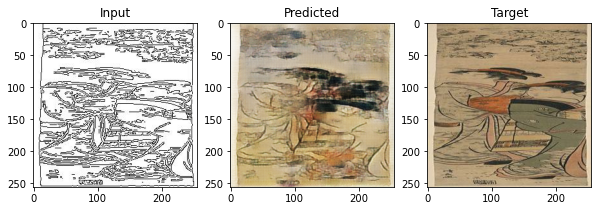

Epoch 6/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 29.1664 - disc_loss: 0.7436
FID: 190.4220433960739

Epoch 00006: fid did not improve from 185.85821
Epoch 7/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 28.4407 - disc_loss: 0.7380
FID: 184.26929421156626

Epoch 00007: fid improved from 185.85821 to 184.26929, saving model to ./checkpoints/style_1_canny_l1/training


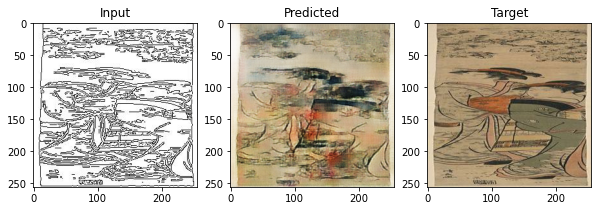

Epoch 8/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 27.6184 - disc_loss: 0.7401
FID: 191.6348791355801

Epoch 00008: fid did not improve from 184.26929
Epoch 9/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 26.7754 - disc_loss: 0.7318
FID: 191.54748081043758

Epoch 00009: fid did not improve from 184.26929
Epoch 10/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 26.0304 - disc_loss: 0.7153
FID: 165.84869603746944

Epoch 00010: fid improved from 184.26929 to 165.84870, saving model to ./checkpoints/style_1_canny_l1/training


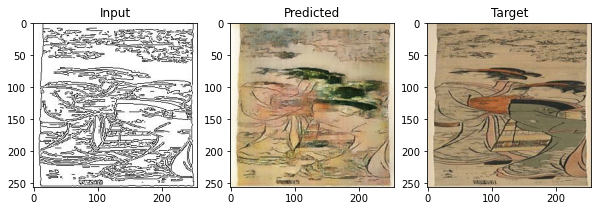

Epoch 11/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 25.2589 - disc_loss: 0.7069
FID: 156.16312030078456

Epoch 00011: fid improved from 165.84870 to 156.16312, saving model to ./checkpoints/style_1_canny_l1/training


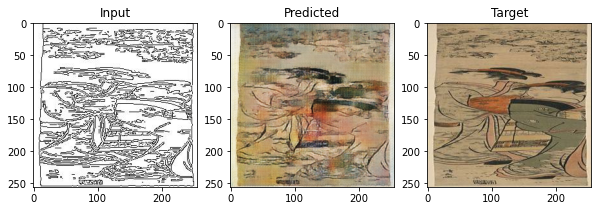

Epoch 12/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 24.8437 - disc_loss: 0.7065
FID: 178.30502547284712

Epoch 00012: fid did not improve from 156.16312
Epoch 13/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 24.3642 - disc_loss: 0.6874
FID: 162.06309670258054

Epoch 00013: fid did not improve from 156.16312
Epoch 14/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 23.8020 - disc_loss: 0.6695
FID: 153.99040171551735

Epoch 00014: fid improved from 156.16312 to 153.99040, saving model to ./checkpoints/style_1_canny_l1/training


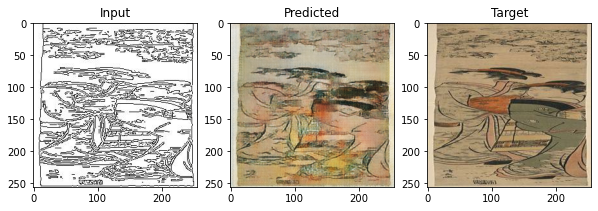

Epoch 15/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 23.3096 - disc_loss: 0.6595
FID: 166.89913586359313

Epoch 00015: fid did not improve from 153.99040
Epoch 16/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 22.8918 - disc_loss: 0.6231
FID: 158.8703404336961

Epoch 00016: fid did not improve from 153.99040
Epoch 17/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 22.3578 - disc_loss: 0.5960
FID: 131.19909169053227

Epoch 00017: fid improved from 153.99040 to 131.19909, saving model to ./checkpoints/style_1_canny_l1/training


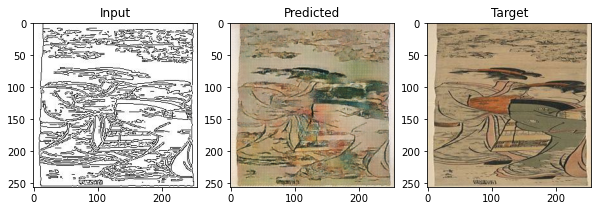

Epoch 18/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 22.2531 - disc_loss: 0.5574
FID: 135.96009816327623

Epoch 00018: fid did not improve from 131.19909
Epoch 19/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 21.9108 - disc_loss: 0.5290
FID: 162.9208320179149

Epoch 00019: fid did not improve from 131.19909
Epoch 20/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 21.6443 - disc_loss: 0.5358
FID: 133.658651232639

Epoch 00020: fid did not improve from 131.19909
Epoch 21/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 21.4050 - disc_loss: 0.4997
FID: 143.059296070541

Epoch 00021: fid did not improve from 131.19909
Epoch 22/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 21.1388 - disc_loss: 0.4848
FID: 140.84121761516712

Epoch 00022: fid did not improve from 131.19909
Epoch 23/100
1013/1013 [==============================] - 120s 119ms/s

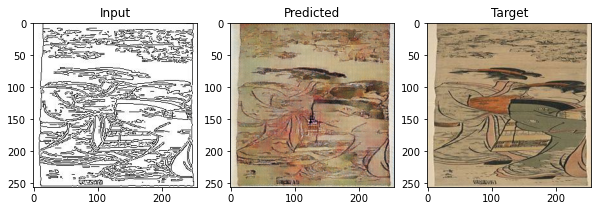

Epoch 25/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 20.7320 - disc_loss: 0.4045
FID: 131.8076981302141

Epoch 00025: fid did not improve from 128.70821
Epoch 26/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 20.4821 - disc_loss: 0.4348
FID: 166.43671382430801

Epoch 00026: fid did not improve from 128.70821
Epoch 27/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 20.4461 - disc_loss: 0.3924
FID: 143.83177377980778

Epoch 00027: fid did not improve from 128.70821
Epoch 28/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 20.2895 - disc_loss: 0.3971
FID: 139.63324095841372

Epoch 00028: fid did not improve from 128.70821
Epoch 29/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 20.2144 - disc_loss: 0.3552
FID: 151.92734780671296

Epoch 00029: fid did not improve from 128.70821
Epoch 30/100
1013/1013 [==============================] - 121s 119

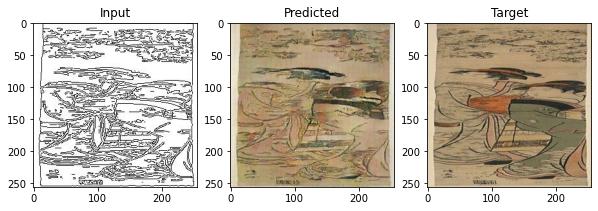

Epoch 34/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 19.3088 - disc_loss: 0.4385
FID: 121.74317507616735

Epoch 00034: fid improved from 127.93962 to 121.74318, saving model to ./checkpoints/style_1_canny_l1/training


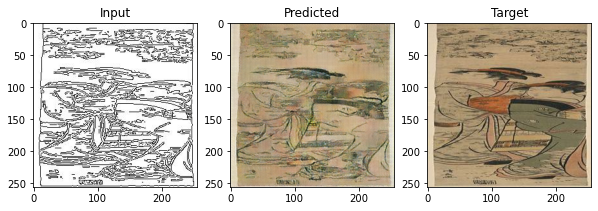

Epoch 35/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 19.3152 - disc_loss: 0.3819
FID: 128.19797264472862

Epoch 00035: fid did not improve from 121.74318
Epoch 36/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 19.1723 - disc_loss: 0.4041
FID: 131.3721817800549

Epoch 00036: fid did not improve from 121.74318
Epoch 37/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 18.9814 - disc_loss: 0.4312
FID: 130.46266212551785

Epoch 00037: fid did not improve from 121.74318
Epoch 38/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 18.9985 - disc_loss: 0.3879
FID: 129.33957966454443

Epoch 00038: fid did not improve from 121.74318
Epoch 39/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 18.8421 - disc_loss: 0.3557
FID: 145.16335058361156

Epoch 00039: fid did not improve from 121.74318
Epoch 40/100
1013/1013 [==============================] - 121s 119

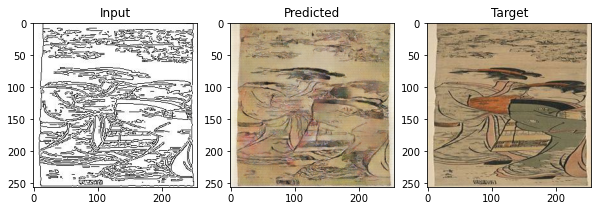

Epoch 52/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 17.4061 - disc_loss: 0.4489
FID: 131.04233664179867

Epoch 00052: fid did not improve from 120.23603
Epoch 53/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 17.1332 - disc_loss: 0.5414
FID: 131.82318829834486

Epoch 00053: fid did not improve from 120.23603
Epoch 54/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 17.2312 - disc_loss: 0.4384
FID: 124.30257503791836

Epoch 00054: fid did not improve from 120.23603
Epoch 55/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 17.0497 - disc_loss: 0.4682
FID: 129.64027051421908

Epoch 00055: fid did not improve from 120.23603
Epoch 56/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 16.9257 - disc_loss: 0.5340
FID: 124.27759591731643

Epoch 00056: fid did not improve from 120.23603
Epoch 57/100
1013/1013 [==============================] - 121s 11

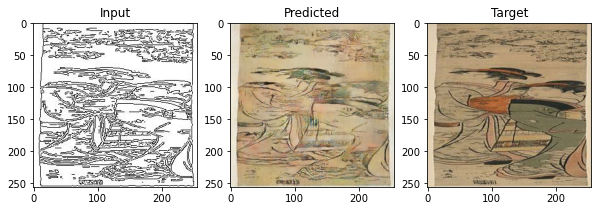

Epoch 62/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 16.4884 - disc_loss: 0.5086
FID: 124.27880108565262

Epoch 00062: fid did not improve from 114.81815
Epoch 63/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 16.4412 - disc_loss: 0.5618
FID: 126.49751625660278

Epoch 00063: fid did not improve from 114.81815
Epoch 64/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 16.3344 - disc_loss: 0.5393
FID: 135.49393992792432

Epoch 00064: fid did not improve from 114.81815
Epoch 65/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 16.3441 - disc_loss: 0.5052
FID: 139.96367516746685

Epoch 00065: fid did not improve from 114.81815
Epoch 66/100
1013/1013 [==============================] - 121s 119ms/step - gen_loss: 16.2815 - disc_loss: 0.5621
FID: 124.95776886057175

Epoch 00066: fid did not improve from 114.81815
Epoch 67/100
1013/1013 [==============================] - 121s 11

In [32]:
train_model('style_1_canny_l1', ds_style_1_canny_train, ds_style_1_canny_test)

<a id="section-trainings-4"></a>

### Trainings: different styles

Epoch 1/100


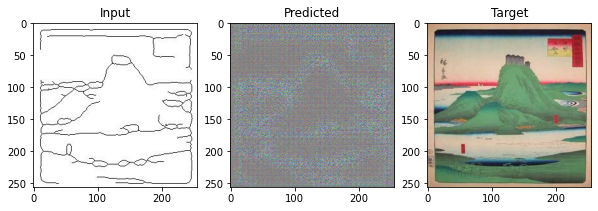

1110/1110 [==============================] - 136s 120ms/step - gen_loss: 36.5186 - disc_loss: 0.5872
FID: 226.4888611754042

Epoch 00001: fid improved from inf to 226.48886, saving model to ./checkpoints/style_2_hed_l1/training


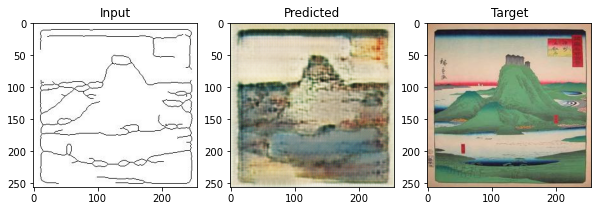

Epoch 2/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 36.4062 - disc_loss: 0.6555
FID: 348.0313339934867

Epoch 00002: fid did not improve from 226.48886


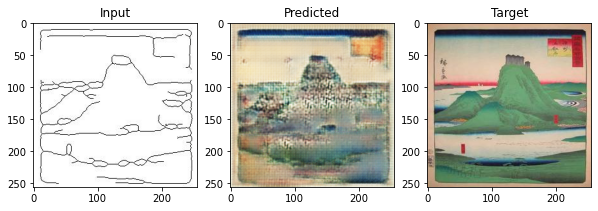

Epoch 3/100
1110/1110 [==============================] - 133s 120ms/step - gen_loss: 35.9597 - disc_loss: 0.7053
FID: 219.33144633116964

Epoch 00003: fid improved from 226.48886 to 219.33145, saving model to ./checkpoints/style_2_hed_l1/training


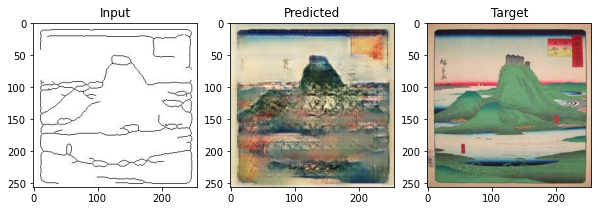

Epoch 4/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 35.1231 - disc_loss: 0.7477
FID: 212.57610228972482

Epoch 00004: fid improved from 219.33145 to 212.57610, saving model to ./checkpoints/style_2_hed_l1/training


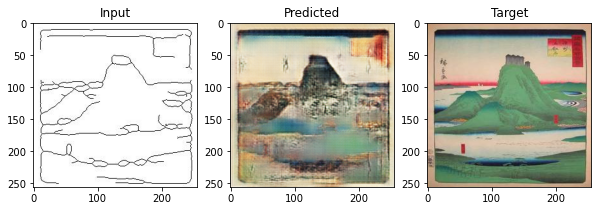

Epoch 5/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 34.0439 - disc_loss: 0.7563
FID: 208.01349425596192

Epoch 00005: fid improved from 212.57610 to 208.01349, saving model to ./checkpoints/style_2_hed_l1/training


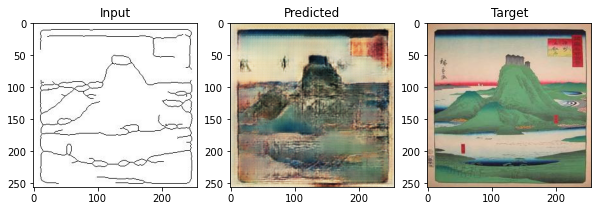

Epoch 6/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 33.1604 - disc_loss: 0.7680
FID: 206.68933548146978

Epoch 00006: fid improved from 208.01349 to 206.68934, saving model to ./checkpoints/style_2_hed_l1/training


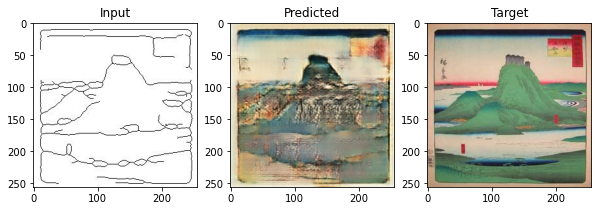

Epoch 7/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 31.9376 - disc_loss: 0.7773
FID: 199.39844569346238

Epoch 00007: fid improved from 206.68934 to 199.39845, saving model to ./checkpoints/style_2_hed_l1/training


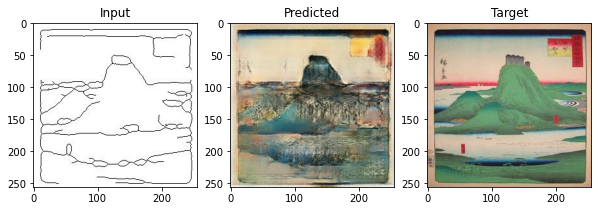

Epoch 8/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 30.9532 - disc_loss: 0.7854
FID: 220.47573851555916

Epoch 00008: fid did not improve from 199.39845
Epoch 9/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 29.9428 - disc_loss: 0.7807
FID: 203.770469923622

Epoch 00009: fid did not improve from 199.39845
Epoch 10/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 28.9088 - disc_loss: 0.7770
FID: 204.14945806453113

Epoch 00010: fid did not improve from 199.39845
Epoch 11/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 27.9503 - disc_loss: 0.7808
FID: 186.35691676095337

Epoch 00011: fid improved from 199.39845 to 186.35692, saving model to ./checkpoints/style_2_hed_l1/training


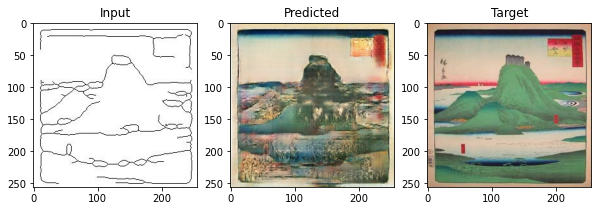

Epoch 12/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 27.0623 - disc_loss: 0.7876
FID: 191.15772001262786

Epoch 00012: fid did not improve from 186.35692
Epoch 13/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 26.4151 - disc_loss: 0.7723
FID: 191.3668513326938

Epoch 00013: fid did not improve from 186.35692
Epoch 14/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 25.7964 - disc_loss: 0.7808
FID: 202.1044172052256

Epoch 00014: fid did not improve from 186.35692
Epoch 15/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 25.2350 - disc_loss: 0.7762
FID: 185.53705544401612

Epoch 00015: fid improved from 186.35692 to 185.53706, saving model to ./checkpoints/style_2_hed_l1/training


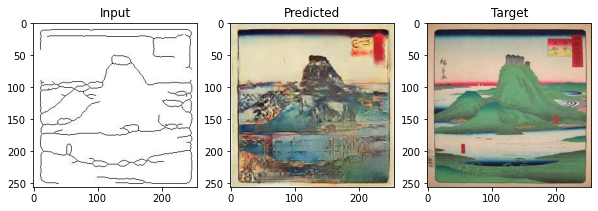

Epoch 16/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 24.6795 - disc_loss: 0.7686
FID: 195.04189973345245

Epoch 00016: fid did not improve from 185.53706
Epoch 17/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 24.2575 - disc_loss: 0.7602
FID: 184.92671322504145

Epoch 00017: fid improved from 185.53706 to 184.92671, saving model to ./checkpoints/style_2_hed_l1/training


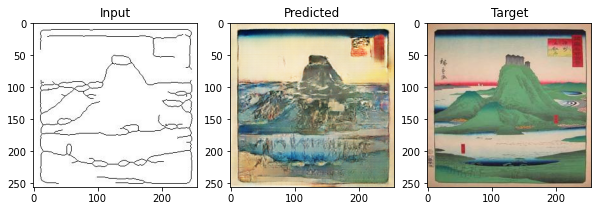

Epoch 18/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 23.8360 - disc_loss: 0.7761
FID: 189.46739828609884

Epoch 00018: fid did not improve from 184.92671
Epoch 19/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 23.4757 - disc_loss: 0.7658
FID: 177.16880751903417

Epoch 00019: fid improved from 184.92671 to 177.16881, saving model to ./checkpoints/style_2_hed_l1/training


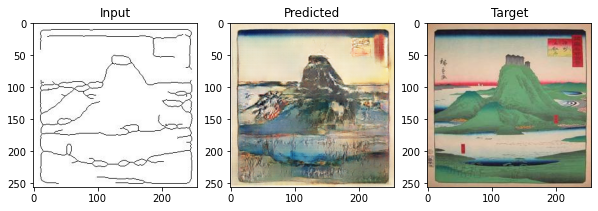

Epoch 20/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 23.0742 - disc_loss: 0.7570
FID: 185.6231075785514

Epoch 00020: fid did not improve from 177.16881
Epoch 21/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 22.6926 - disc_loss: 0.7663
FID: 176.85726232815347

Epoch 00021: fid improved from 177.16881 to 176.85726, saving model to ./checkpoints/style_2_hed_l1/training


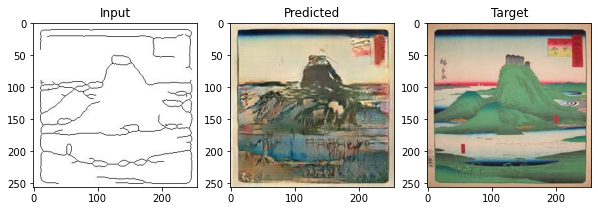

Epoch 22/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 22.4741 - disc_loss: 0.7565
FID: 170.93535370714756

Epoch 00022: fid improved from 176.85726 to 170.93535, saving model to ./checkpoints/style_2_hed_l1/training


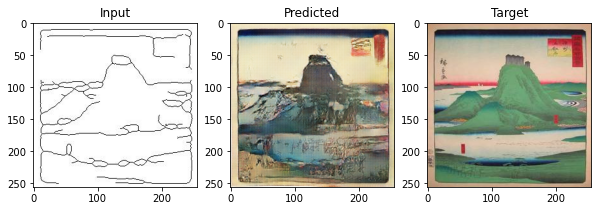

Epoch 23/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 22.1027 - disc_loss: 0.7630
FID: 170.74773745777858

Epoch 00023: fid improved from 170.93535 to 170.74774, saving model to ./checkpoints/style_2_hed_l1/training


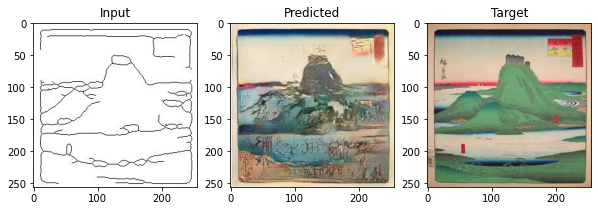

Epoch 24/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 21.8213 - disc_loss: 0.7567
FID: 171.06614882367808

Epoch 00024: fid did not improve from 170.74774
Epoch 25/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 21.6142 - disc_loss: 0.7611
FID: 171.1938909959518

Epoch 00025: fid did not improve from 170.74774
Epoch 26/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 21.3367 - disc_loss: 0.7632
FID: 178.58327538967114

Epoch 00026: fid did not improve from 170.74774
Epoch 27/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 21.0708 - disc_loss: 0.7716
FID: 171.58607415320782

Epoch 00027: fid did not improve from 170.74774
Epoch 28/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 20.8521 - disc_loss: 0.7678
FID: 182.1676057751739

Epoch 00028: fid did not improve from 170.74774
Epoch 29/100
1110/1110 [==============================] - 132s 119m

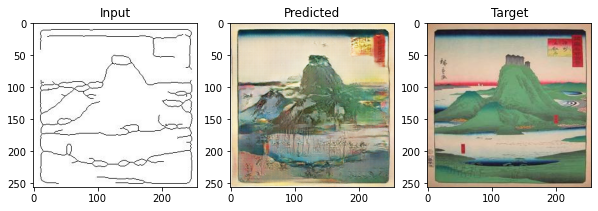

Epoch 31/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 20.2791 - disc_loss: 0.7693
FID: 169.180180535971

Epoch 00031: fid did not improve from 167.48898
Epoch 32/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 20.0644 - disc_loss: 0.7685
FID: 165.83263911003945

Epoch 00032: fid improved from 167.48898 to 165.83264, saving model to ./checkpoints/style_2_hed_l1/training


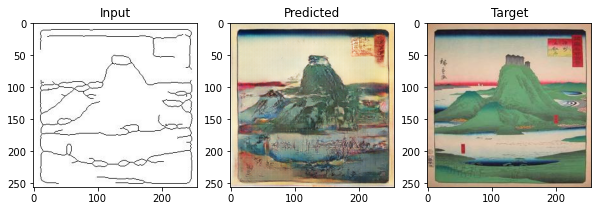

Epoch 33/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 19.9232 - disc_loss: 0.7555
FID: 158.5072935504116

Epoch 00033: fid improved from 165.83264 to 158.50729, saving model to ./checkpoints/style_2_hed_l1/training


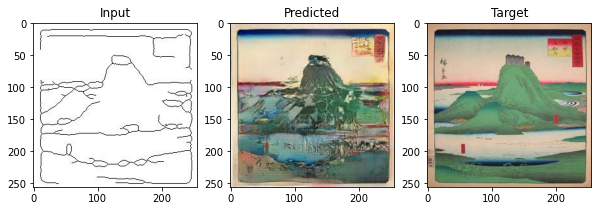

Epoch 34/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 19.7460 - disc_loss: 0.7656
FID: 164.65917526955718

Epoch 00034: fid did not improve from 158.50729
Epoch 35/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 19.6302 - disc_loss: 0.7654
FID: 164.07203219267518

Epoch 00035: fid did not improve from 158.50729
Epoch 36/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 19.4974 - disc_loss: 0.7583
FID: 171.4801401043615

Epoch 00036: fid did not improve from 158.50729
Epoch 37/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 19.3550 - disc_loss: 0.7587
FID: 159.1186659814311

Epoch 00037: fid did not improve from 158.50729
Epoch 38/100
1110/1110 [==============================] - 133s 120ms/step - gen_loss: 19.1660 - disc_loss: 0.7594
FID: 162.12804678053044

Epoch 00038: fid did not improve from 158.50729
Epoch 39/100
1110/1110 [==============================] - 133s 119m

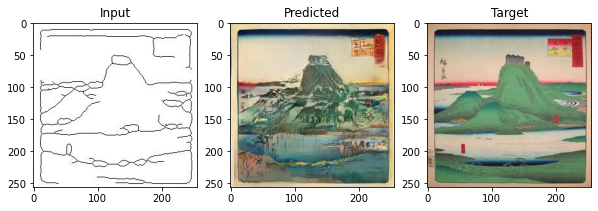

Epoch 40/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 18.9565 - disc_loss: 0.7524
FID: 161.30753181075397

Epoch 00040: fid did not improve from 157.34145
Epoch 41/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 18.9353 - disc_loss: 0.7403
FID: 164.2736224019694

Epoch 00041: fid did not improve from 157.34145
Epoch 42/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 18.8259 - disc_loss: 0.7332
FID: 152.62335140433856

Epoch 00042: fid improved from 157.34145 to 152.62335, saving model to ./checkpoints/style_2_hed_l1/training


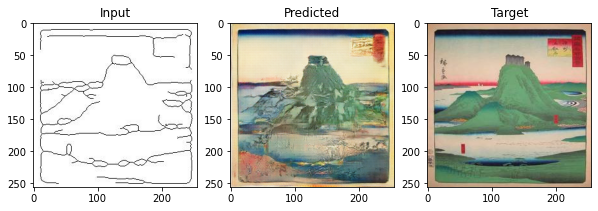

Epoch 43/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 18.7347 - disc_loss: 0.7273
FID: 156.15626803739994

Epoch 00043: fid did not improve from 152.62335
Epoch 44/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 18.6815 - disc_loss: 0.7134
FID: 157.87850853105996

Epoch 00044: fid did not improve from 152.62335
Epoch 45/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 18.6749 - disc_loss: 0.6927
FID: 155.35453358884274

Epoch 00045: fid did not improve from 152.62335
Epoch 46/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 18.6530 - disc_loss: 0.6607
FID: 155.51032128662789

Epoch 00046: fid did not improve from 152.62335
Epoch 47/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 18.6667 - disc_loss: 0.6444
FID: 155.77209334714877

Epoch 00047: fid did not improve from 152.62335
Epoch 48/100
1110/1110 [==============================] - 133s 11

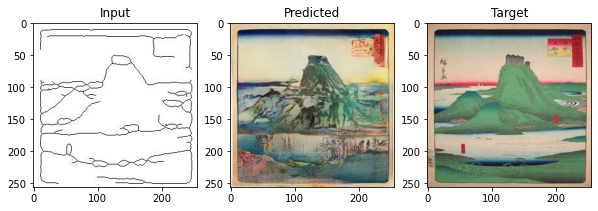

Epoch 49/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 18.9531 - disc_loss: 0.5414
FID: 152.5431552954597

Epoch 00049: fid did not improve from 147.77557
Epoch 50/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 19.3870 - disc_loss: 0.4337
FID: 153.21549037399893

Epoch 00050: fid did not improve from 147.77557
Epoch 51/100
1110/1110 [==============================] - 132s 119ms/step - gen_loss: 19.8121 - disc_loss: 0.3759
FID: 155.07899030849666

Epoch 00051: fid did not improve from 147.77557
Epoch 52/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 20.1500 - disc_loss: 0.3239
FID: 153.12096439719915

Epoch 00052: fid did not improve from 147.77557
Epoch 53/100
1110/1110 [==============================] - 133s 119ms/step - gen_loss: 20.4759 - disc_loss: 0.2927
FID: 155.33461716264173

Epoch 00053: fid did not improve from 147.77557
Epoch 54/100
1110/1110 [==============================] - 133s 119

In [33]:
train_model('style_2_hed_l1', ds_style_2_hed_train, ds_style_2_hed_test)

<a id="section-four"></a>

## Evaluation

In [38]:
!ls checkpoints

style_1_canny_l1
style_1_hed
style_1_hed_l1
style_1_hed_l2
style_2_hed_l1


In [76]:
def load_model(name):
    model = create_model()
    model.load_weights(tf.train.latest_checkpoint(CHECKPOINT_DIR + '/' + name))
    history_path = CHECKPOINT_DIR + '/' + name + '/history.npy'
    history = np.load(history_path, allow_pickle=True).item()
    return model, history

In [80]:
model_style_1_hed, history_style_1_hed = load_model('style_1_hed')
model_style_1_hed_l1, history_style_1_hed_l1 = load_model('style_1_hed_l1')
model_style_1_hed_l2, history_style_1_hed_l2 = load_model('style_1_hed_l2')

model_style_1_canny_l1, history_style_1_canny_l1 = load_model('style_1_canny_l1')

model_style_2_hed_l1, history_style_2_hed_l1 = load_model('style_2_hed_l1')

<a id="section-evaluation-1"></a>

### Study of the convergence

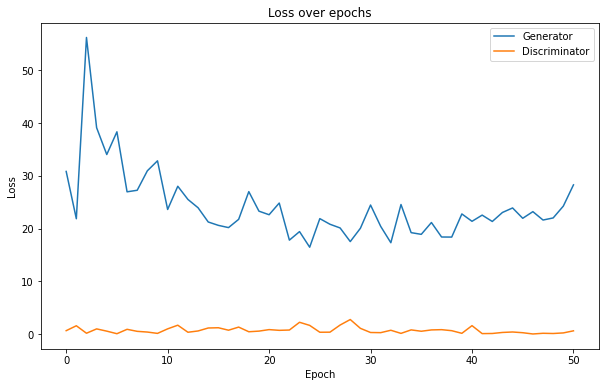

In [81]:
plt.figure(figsize=(10, 6))
plt.plot(history_style_1_hed_l1['gen_loss'])
plt.plot(history_style_1_hed_l1['disc_loss'])
plt.title('Loss over epochs')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Generator', 'Discriminator'])
plt.show()

<a id="section-evaluation-2"></a>

### Effect of different regularization methods

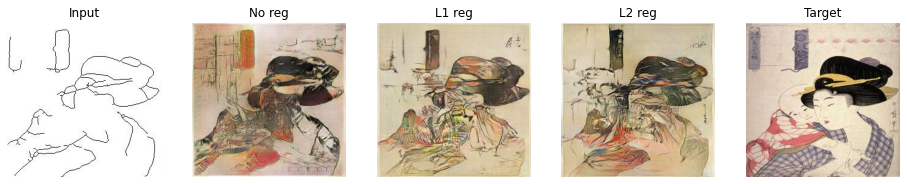

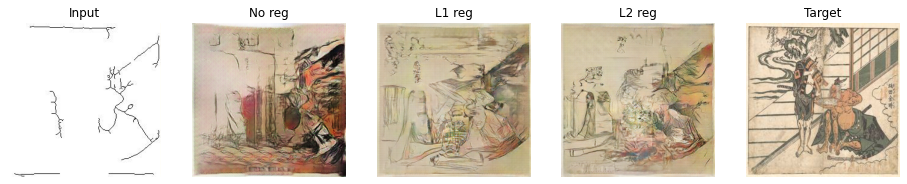

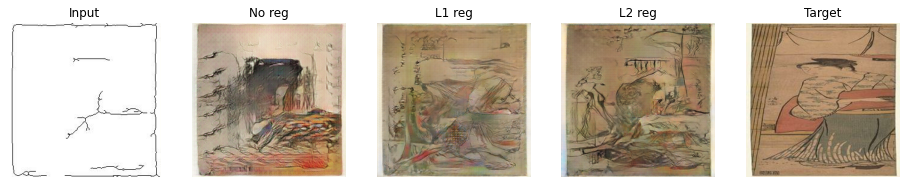

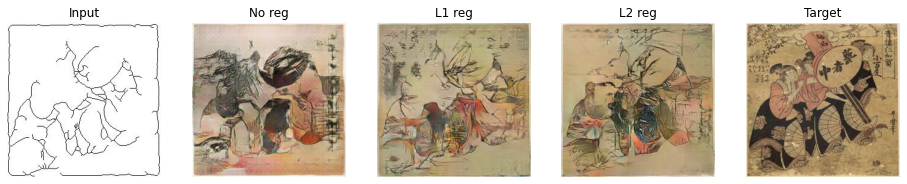

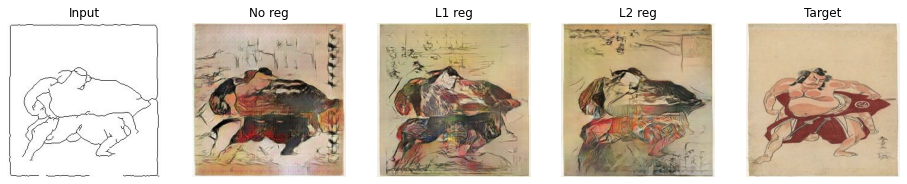

In [114]:
for input_image, target_image in ds_style_1_hed_test.take(5):
    plt.figure(figsize=(16, 10))

    plt.subplot(1, 5, 1)
    plt.title('Input')
    plt.imshow(input_image[0] * 0.5 + 0.5)
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.title('No reg')
    plt.imshow(model_style_1_hed(input_image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 5, 3)
    plt.title('L1 reg')
    plt.imshow(model_style_1_hed_l1(input_image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 5, 4)
    plt.title('L2 reg')
    plt.imshow(model_style_1_hed_l2(input_image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.title('Target')
    plt.imshow(target_image[0] * 0.5 + 0.5)
    plt.axis('off')

    plt.show()

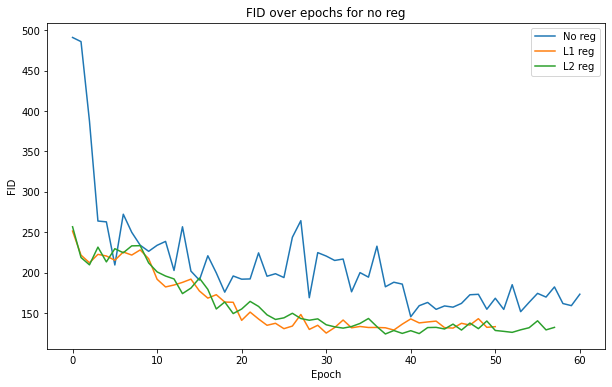

In [88]:
plt.figure(figsize=(10, 6))
plt.plot(history_style_1_hed['fid'])
plt.plot(history_style_1_hed_l1['fid'])
plt.plot(history_style_1_hed_l2['fid'])
plt.title('FID over epochs for no reg')
plt.ylabel('FID')
plt.xlabel('Epoch')
plt.legend(['No reg', 'L1 reg', 'L2 reg'])
plt.show()

<a id="section-evaluation-3"></a>

### Effect of different edge extraction techniques

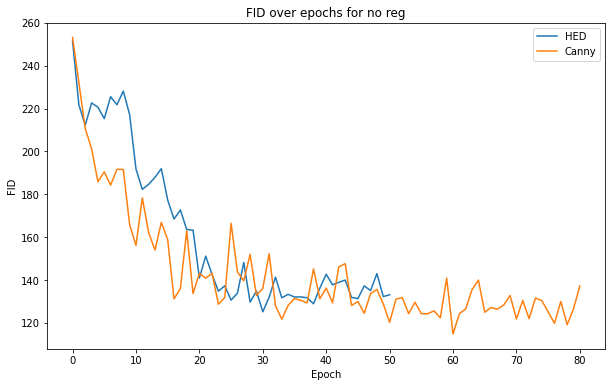

In [87]:
plt.figure(figsize=(10, 6))
plt.plot(history_style_1_hed_l1['fid'])
plt.plot(history_style_1_canny_l1['fid'])
plt.title('FID over epochs for no reg')
plt.ylabel('FID')
plt.xlabel('Epoch')
plt.legend(['HED', 'Canny'])
plt.show()

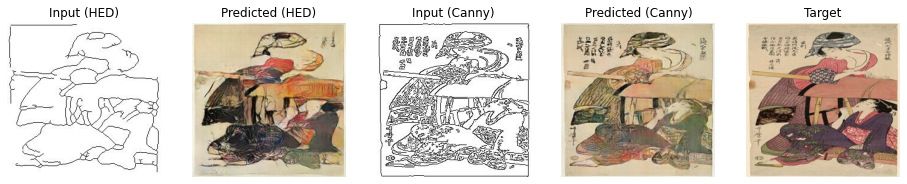

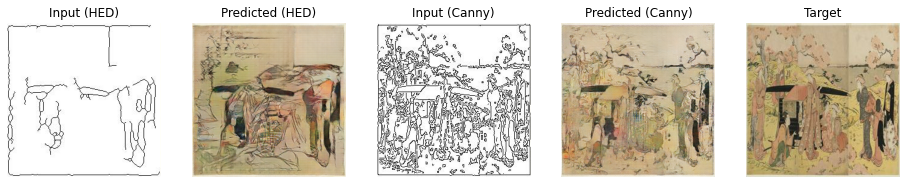

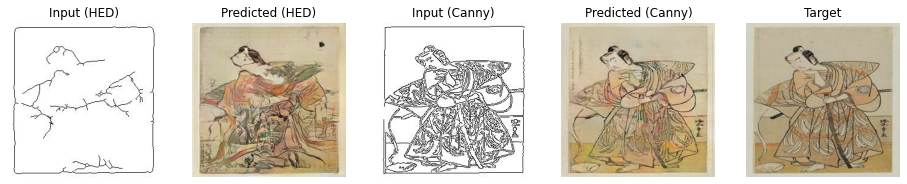

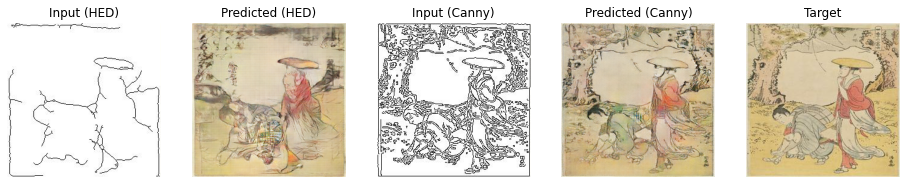

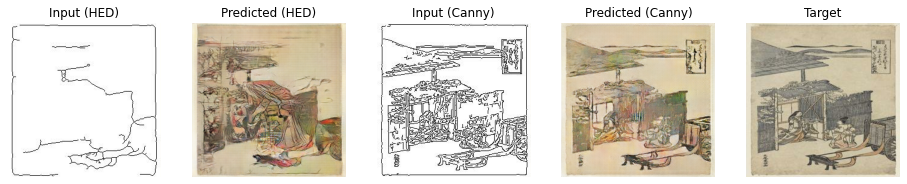

In [115]:
import random

images = glob(str(DATA_PATH / 'style_1/HED/train/*'))
random.shuffle(images)

for image_path in images[:5]:
    input_image_hed, target_image = preprocess_image(image_path)
    input_image_canny, _ = preprocess_image(image_path.replace('HED', 'CANNY'))
    
    input_image_hed = np.expand_dims(input_image_hed, axis=0)
    input_image_canny = np.expand_dims(input_image_canny, axis=0)
    
    plt.figure(figsize=(16, 10))

    plt.subplot(1, 5, 1)
    plt.title('Input (HED)')
    plt.imshow(input_image_hed[0] * 0.5 + 0.5)
    plt.axis('off')

    plt.subplot(1, 5, 2)
    plt.title('Predicted (HED)')
    plt.imshow(model_style_1_hed_l1(input_image_hed, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 5, 3)
    plt.title('Input (Canny)')
    plt.imshow(input_image_canny[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 5, 4)
    plt.title('Predicted (Canny)')
    plt.imshow(model_style_1_canny_l1(input_image_canny, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')

    plt.subplot(1, 5, 5)
    plt.title('Target')
    plt.imshow(target_image * 0.5 + 0.5)
    plt.axis('off')

    plt.show()

In [90]:
def load_test_image(path):
    image = tf.io.decode_jpeg(tf.io.read_file(path))
    image = tf.cast(image, tf.float32)
    image = (image / 127.5) - 1
    return image    

In [91]:
DRAWINGS_DATASET_URL = 'https://lab.theolepage.com/upload/datasets/edges2estampes_drawings.zip'

dataset_path = tf.keras.utils.get_file(fname='edges2estampes_drawings.zip', origin=DRAWINGS_DATASET_URL, extract=True)
DRAWINGS_DATA_PATH = pathlib.Path(dataset_path).parent / 'edges2estampes_drawings'

98304/90731 [================================] - 0s 0us/step


In [92]:
drawings_dataset = tf.data.Dataset.list_files(str(DRAWINGS_DATA_PATH / '*.jpg'))
drawings_dataset = drawings_dataset.map(load_test_image)
drawings_dataset = drawings_dataset.batch(1)

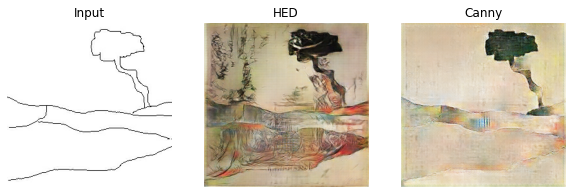

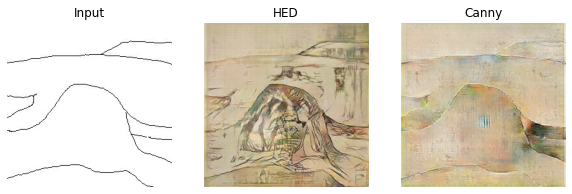

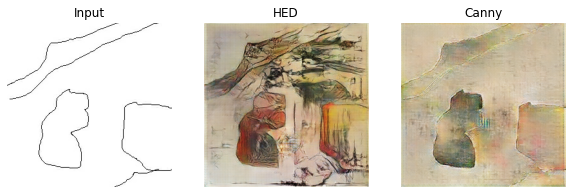

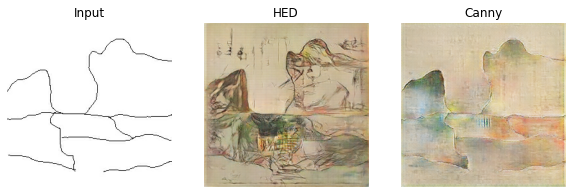

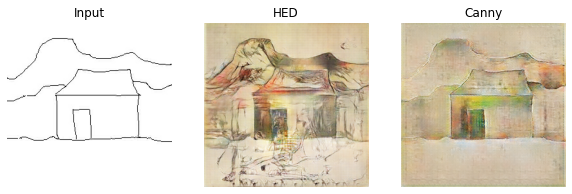

In [116]:
for image in drawings_dataset:
    plt.figure(figsize=(10, 10))
    
    plt.subplot(1, 3, 1)
    plt.title('Input')
    plt.imshow(image[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.title('HED')
    plt.imshow(model_style_1_hed_l1(image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.title('Canny')
    plt.imshow(model_style_1_canny_l1(image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.show()

<a id="section-evaluation-4"></a>

### Effect of a different style

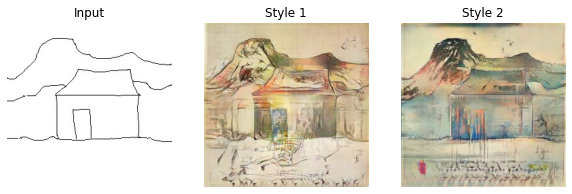

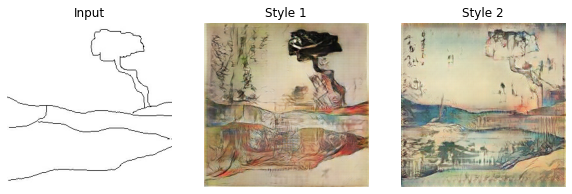

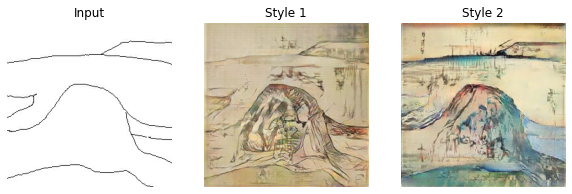

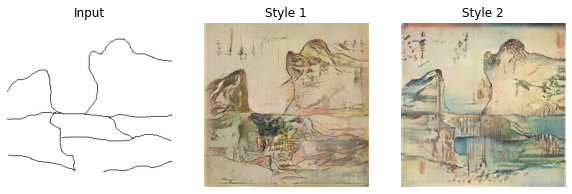

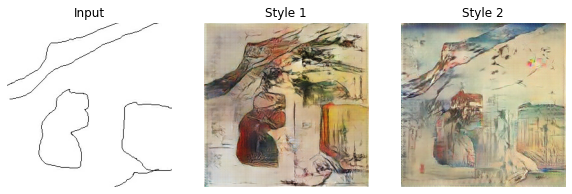

In [117]:
for image in drawings_dataset:
    plt.figure(figsize=(10, 10))
    
    plt.subplot(1, 3, 1)
    plt.title('Input')
    plt.imshow(image[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 3, 2)
    plt.title('Style 1')
    plt.imshow(model_style_1_hed_l1(image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.subplot(1, 3, 3)
    plt.title('Style 2')
    plt.imshow(model_style_2_hed_l1(image, training=True)[0] * 0.5 + 0.5)
    plt.axis('off')
    
    plt.show()

<a id="section-evaluation-5"></a>

### Qualitative and quantitative evaluation of best models

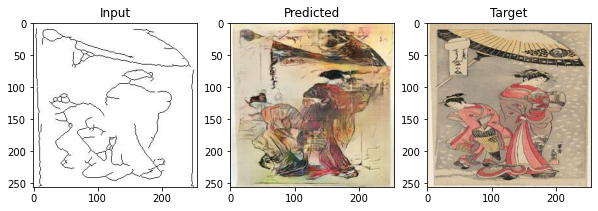

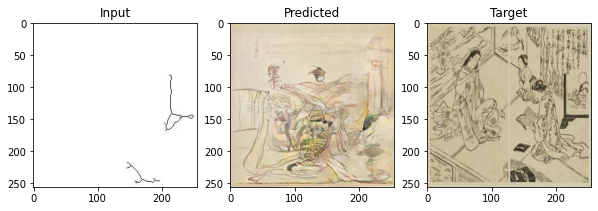

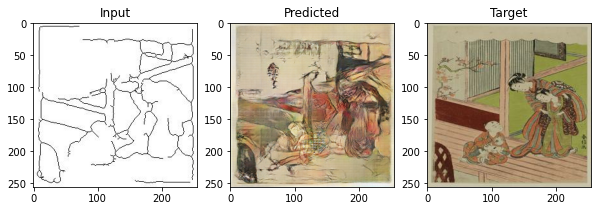

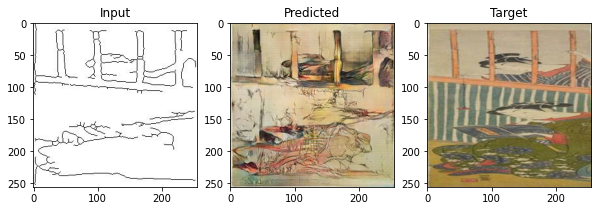

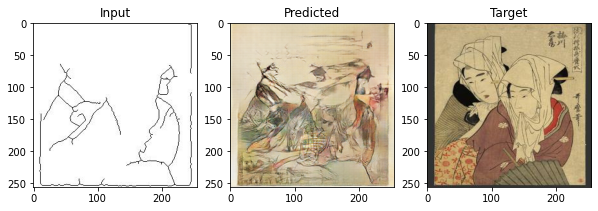

...

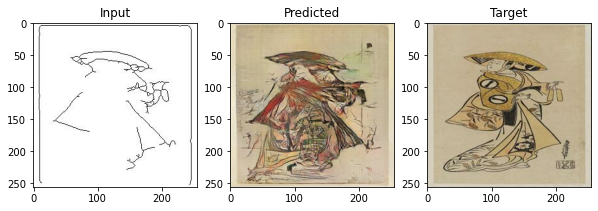

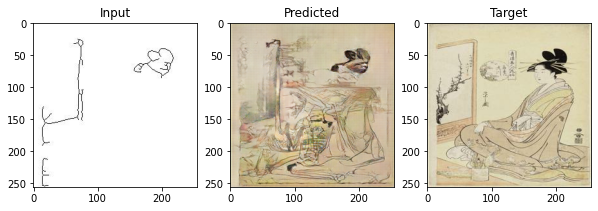

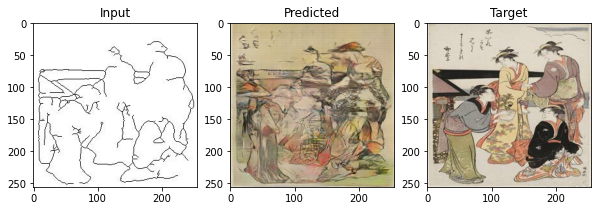

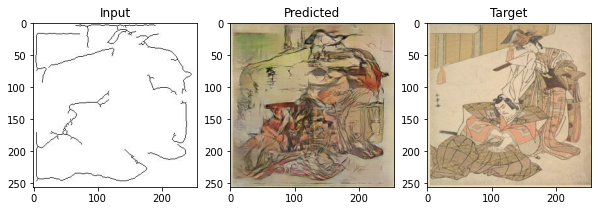

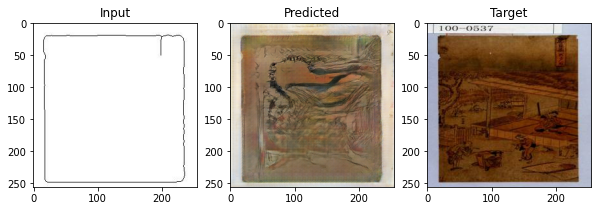

In [102]:
for input_image, target_image in ds_style_1_hed_test.take(20):
    plot_results(model_style_1_hed_l1, input_image, target_image)

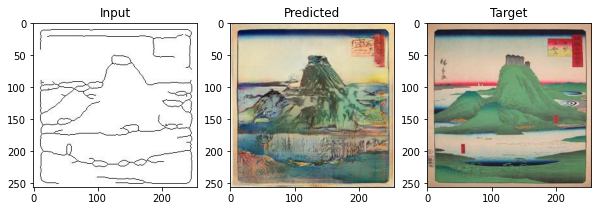

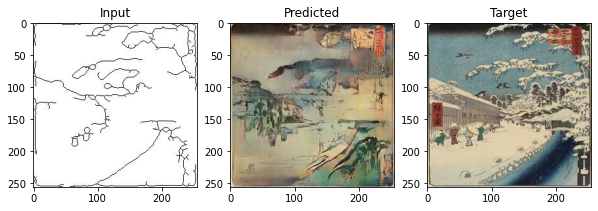

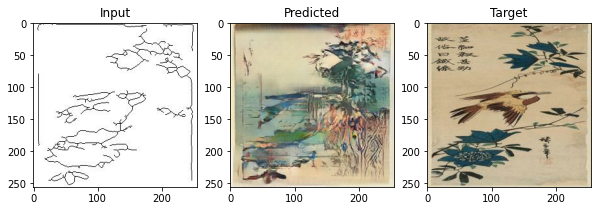

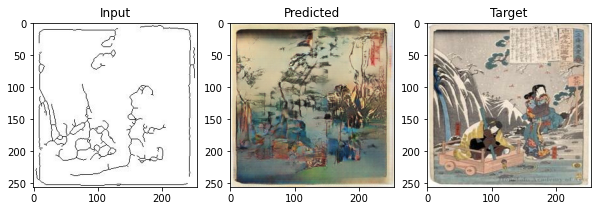

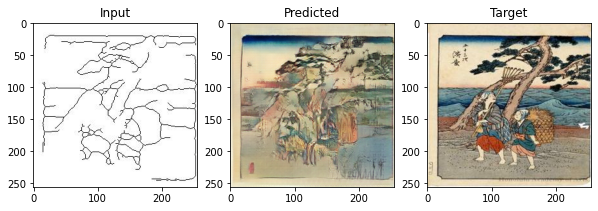

...

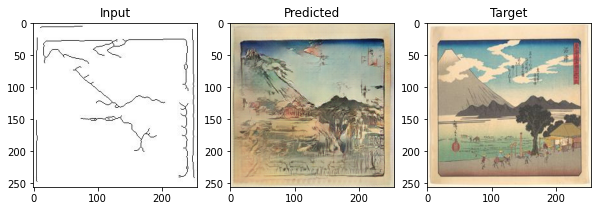

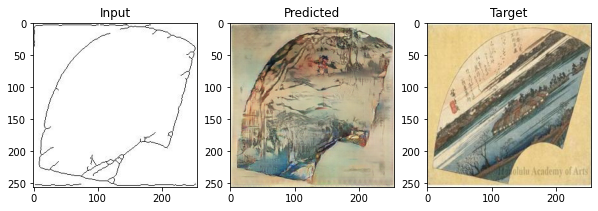

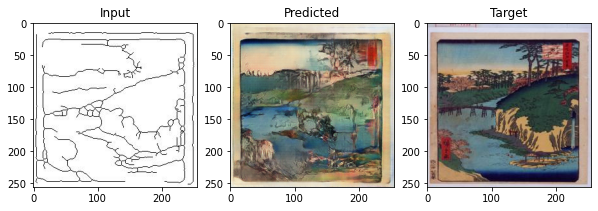

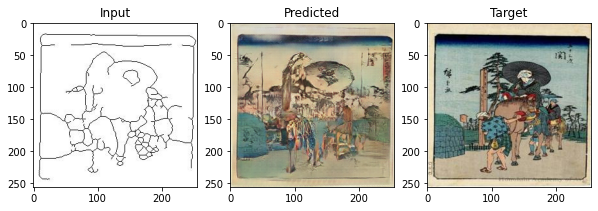

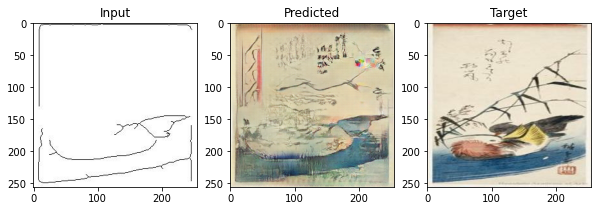

In [101]:
for input_image, target_image in ds_style_2_hed_test.take(20):
    plot_results(model_style_2_hed_l1, input_image, target_image)

In [98]:
min(history_style_1_hed_l1['fid']), min(history_style_2_hed_l1['fid'])

(125.16196623162554, 147.7755695551955)